In [1]:
print("Importing libraries")
import torch
from torch.nn import CrossEntropyLoss
from torch.utils.data import DataLoader
import numpy as np
import os
import nrrd
import pytorch_lightning as pl #python -m pip install lightning
print("Importing MONAI")
from monai.data import CacheDataset, DataLoader
from monai.transforms import Compose, Lambda, RandSpatialCrop, RandRotate90, ToTensor, ScaleIntensityRange
from monai.networks.nets import AutoEncoder
from monai.losses import SSIMLoss
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
from pytorch_lightning.callbacks import ModelCheckpoint
import torch.nn as nn
import torch.optim.lr_scheduler as lr_scheduler
import time
print("Done importing libraries")

Importing libraries


Importing MONAI


Done importing libraries


In [2]:
#Using AutoEncoder instead of UNet to avoid skip connections 
class SlicePlotter:
    def __init__(self):
        pass

    def plot_slices(self, original_slice, reconstruction_slice, title):
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(original_slice, cmap='gray')
        plt.title(f'Original {title} Slice\nMin: {original_slice.min().round(2)}, Max: {original_slice.max().round(2)}')
        plt.colorbar()
        plt.subplot(1, 2, 2)
        plt.imshow(reconstruction_slice, cmap='gray')  # Specify vmin and vmax here , vmin=-0.5, vmax=0.5
        plt.title(f'Reconstructed {title} Slice\nMin: {reconstruction_slice.min().round(2)}, Max: {reconstruction_slice.max().round(2)}')
        plt.colorbar()
        plt.show()
    
    def plot_histograms(self, original_slice, reconstruction_slice, title):
        fig, axes = plt.subplots(1, 2, figsize=(15, 5))

        # Plot histogram for original slice
        axes[0].hist(original_slice.flatten(), bins=50, color='b', alpha=0.7)
        axes[0].set_title(f'Original {title} Slice Histogram')
        axes[0].set_xlabel('Pixel Value')
        axes[0].set_ylabel('Frequency')

        # Plot histogram for reconstruction slice
        axes[1].hist(reconstruction_slice.flatten(), bins=50, color='r', alpha=0.7)
        axes[1].set_title(f'Reconstructed {title} Slice Histogram')
        axes[1].set_xlabel('Pixel Value')
        axes[1].set_ylabel('Frequency')

        plt.tight_layout()
        plt.show()

class AutoEncoderModel(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.autoencoder = AutoEncoder(
            spatial_dims=3, 
            in_channels=1,  
            out_channels=1,  
            channels=(16, 32, 64, 128, 2), 
            strides=(2, 2, 2, 2, 2), 
            kernel_size=3, 
            num_res_units=2
            
        )
        self.loss_function =  nn.MSELoss()
        self.slice_plotter = SlicePlotter()

    def forward(self, x):
        return self.autoencoder(x)
   
    def training_step(self, batch, batch_idx):
        x, y = batch
        # x = x.unsqueeze(1)  # Add channel dimension
        # y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('train_loss', loss)

        if self.current_epoch % ShowInterval == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Train Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Train Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Train Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        # x = x.unsqueeze(1)  # Add channel dimension
        # y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('val_loss', loss)

        if self.current_epoch % ShowInterval == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Val Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Val Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Val Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=1e-4)
        return optimizer

class MyDataset(CacheDataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform
        self.files = [f for f in os.listdir(data_dir) if f.endswith('.nrrd')]

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file_path = os.path.join(self.data_dir, self.files[idx])
        data, header = nrrd.read(file_path)
        if self.transform:
            data = self.transform(data)
        return data, data

class PlotLossCallback(pl.Callback):
    def __init__(self, log_dir):
        super().__init__()
        self.writer = SummaryWriter(log_dir)

    def on_train_epoch_end(self, trainer, pl_module, **kwargs):
        epoch = trainer.current_epoch
        train_loss = trainer.callback_metrics['train_loss'].cpu().item()
        val_loss = trainer.callback_metrics['val_loss'].cpu().item()

        self.writer.add_scalars(ExperimentDescription, {'training': train_loss, 'validation': val_loss}, global_step=epoch + 1)
        time_spent = time.time() - start_time
        
        print(f"Time Spent {time_spent:.2f}")
        print(f"Epoch: {epoch + 1}")
    def on_train_end(self, trainer, pl_module):
        self.writer.close()

folder_path = "./Models"
if not os.path.exists(folder_path):
        os.makedirs(folder_path)

checkpoint_callback = pl.callbacks.ModelCheckpoint(
    dirpath= folder_path,
    filename='I-AE{epoch}.pth',
    save_last=True,
    verbose=True,
    every_n_epochs=200
)

transform = Compose([
    Lambda(func=lambda x: np.expand_dims(x, 0) if x.ndim == 3 else x),
    RandSpatialCrop((256, 256, 256), random_size=False),
    RandRotate90(prob=0.5),
    ScaleIntensityRange(a_min=-1310, a_max=3310, b_min=-1, b_max=1, clip=True),  # Normalize between -1 and 1
    ToTensor(dtype=torch.float32)
])

In [3]:
start_time = time.time()
device = torch.device("cuda" if torch.cuda.is_available() else "gpu")

train_data_dir = "../../train70"
val_data_dir   = "../../val30"

train_dataset_uc = MyDataset(train_data_dir, transform)
val_dataset_uc   = MyDataset(val_data_dir  , transform)

train_dataset = CacheDataset(train_dataset_uc) # , num_workers=1
val_dataset   = CacheDataset(val_dataset_uc  ) # , num_workers=1

train_dataloader = DataLoader(train_dataset, batch_size=2, shuffle=True ) # ,  num_workers=1
val_dataloader   = DataLoader(val_dataset,   batch_size=2, shuffle=False) # ,  num_workers=1

Loading dataset:   0%|          | 0/28 [00:00<?, ?it/s]

Loading dataset:   4%|▎         | 1/28 [00:03<01:43,  3.84s/it]

Loading dataset:   7%|▋         | 2/28 [00:15<03:32,  8.17s/it]

Loading dataset:  11%|█         | 3/28 [00:23<03:25,  8.24s/it]

Loading dataset:  14%|█▍        | 4/28 [00:29<03:01,  7.58s/it]

Loading dataset:  18%|█▊        | 5/28 [00:40<03:20,  8.73s/it]

Loading dataset:  21%|██▏       | 6/28 [00:49<03:11,  8.71s/it]

Loading dataset:  25%|██▌       | 7/28 [00:55<02:46,  7.95s/it]

Loading dataset:  29%|██▊       | 8/28 [01:05<02:49,  8.47s/it]

Loading dataset:  32%|███▏      | 9/28 [01:13<02:37,  8.31s/it]

Loading dataset:  36%|███▌      | 10/28 [01:19<02:19,  7.76s/it]

Loading dataset:  39%|███▉      | 11/28 [01:26<02:04,  7.35s/it]

Loading dataset:  43%|████▎     | 12/28 [01:35<02:07,  7.94s/it]

Loading dataset:  46%|████▋     | 13/28 [01:44<02:02,  8.15s/it]

Loading dataset:  50%|█████     | 14/28 [01:53<01:57,  8.41s/it]

Loading dataset:  54%|█████▎    | 15/28 [01:59<01:41,  7.79s/it]

Loading dataset:  57%|█████▋    | 16/28 [02:05<01:25,  7.09s/it]

Loading dataset:  61%|██████    | 17/28 [02:10<01:14,  6.74s/it]

Loading dataset:  64%|██████▍   | 18/28 [02:21<01:18,  7.82s/it]

Loading dataset:  68%|██████▊   | 19/28 [02:34<01:24,  9.39s/it]

Loading dataset:  71%|███████▏  | 20/28 [02:38<01:03,  7.94s/it]

Loading dataset:  75%|███████▌  | 21/28 [02:45<00:52,  7.44s/it]

Loading dataset:  79%|███████▊  | 22/28 [02:53<00:46,  7.80s/it]

Loading dataset:  82%|████████▏ | 23/28 [03:00<00:37,  7.55s/it]

Loading dataset:  86%|████████▌ | 24/28 [03:10<00:33,  8.26s/it]

Loading dataset:  89%|████████▉ | 25/28 [03:18<00:24,  8.02s/it]

Loading dataset:  93%|█████████▎| 26/28 [03:24<00:15,  7.66s/it]

Loading dataset:  96%|█████████▋| 27/28 [03:30<00:06,  7.00s/it]

Loading dataset: 100%|██████████| 28/28 [03:36<00:00,  6.68s/it]

Loading dataset: 100%|██████████| 28/28 [03:36<00:00,  7.73s/it]

Loading dataset:   0%|          | 0/12 [00:00<?, ?it/s]

Loading dataset:   8%|▊         | 1/12 [00:05<01:05,  5.97s/it]

Loading dataset:  17%|█▋        | 2/12 [00:13<01:09,  6.93s/it]

Loading dataset:  25%|██▌       | 3/12 [00:20<01:00,  6.71s/it]

Loading dataset:  33%|███▎      | 4/12 [00:36<01:25, 10.67s/it]

Loading dataset:  42%|████▏     | 5/12 [00:43<01:04,  9.22s/it]

Loading dataset:  50%|█████     | 6/12 [00:52<00:55,  9.18s/it]

Loading dataset:  58%|█████▊    | 7/12 [01:03<00:49,  9.91s/it]

Loading dataset:  67%|██████▋   | 8/12 [01:10<00:34,  8.71s/it]

Loading dataset:  75%|███████▌  | 9/12 [01:17<00:25,  8.43s/it]

Loading dataset:  83%|████████▎ | 10/12 [01:25<00:16,  8.27s/it]

Loading dataset:  92%|█████████▏| 11/12 [01:34<00:08,  8.45s/it]

Loading dataset: 100%|██████████| 12/12 [01:44<00:00,  8.92s/it]

Loading dataset: 100%|██████████| 12/12 [01:44<00:00,  8.72s/it]

In [4]:
trainer = pl.Trainer(
    max_epochs=1501,
    callbacks=[PlotLossCallback("../../logs/"), checkpoint_callback],
    profiler='simple'
)

GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


Missing logger folder: /old_Users/tgafrick/RA4/jobs/job14/lightning_logs


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



  | Name          | Type        | Params
----------------------------------------------
0 | autoencoder   | AutoEncoder | 2.1 M 
1 | loss_function | MSELoss     | 0     
----------------------------------------------
2.1 M     Trainable params
0         Non-trainable params
2.1 M     Total params
8.277     Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=63` in the `DataLoader` to improve performance.


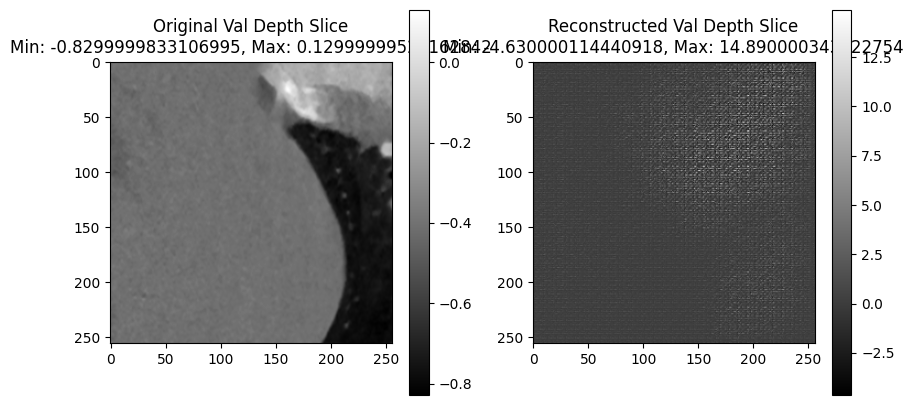

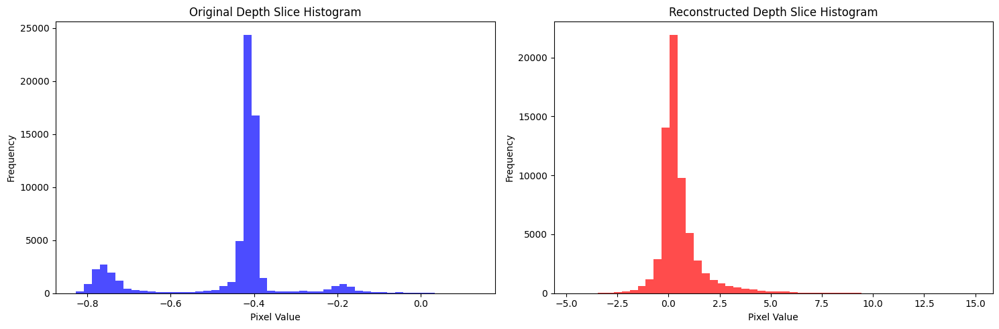

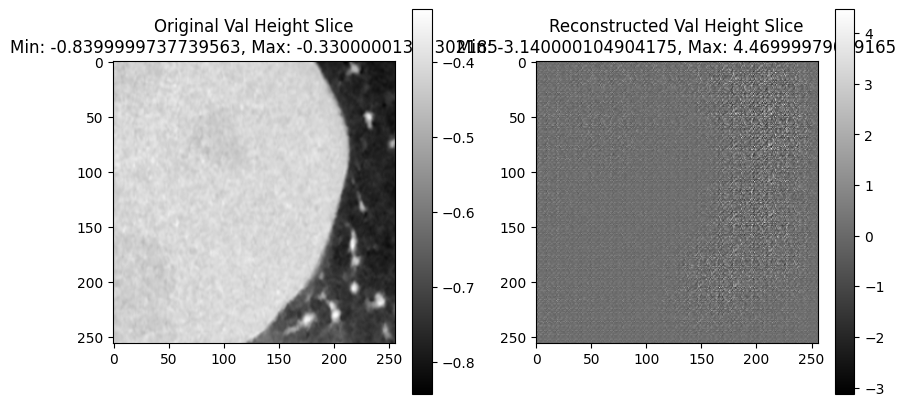

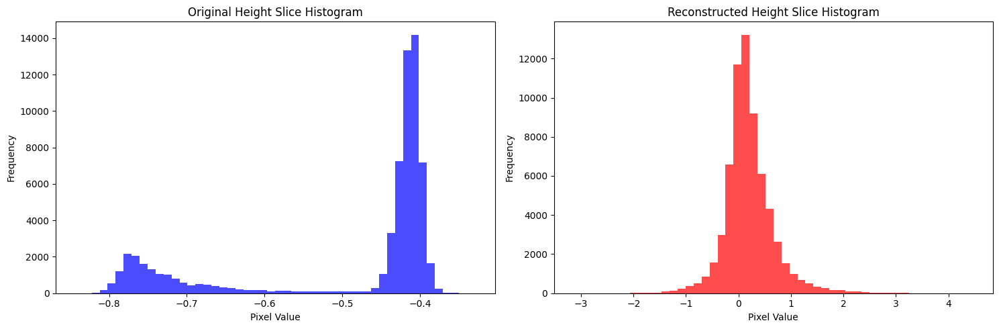

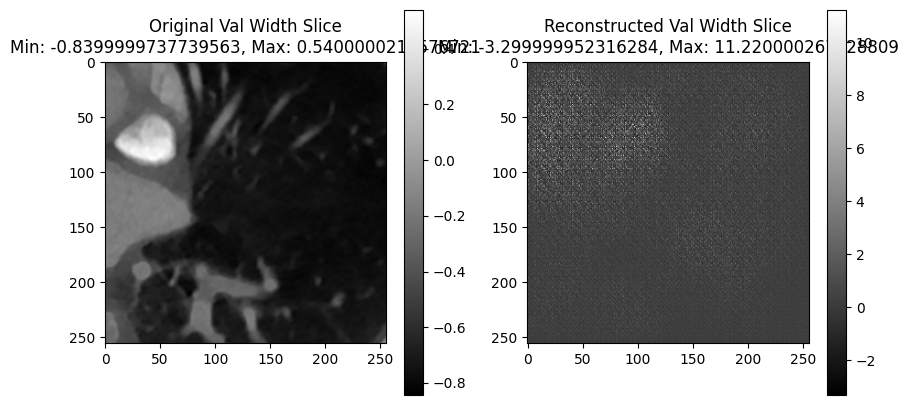

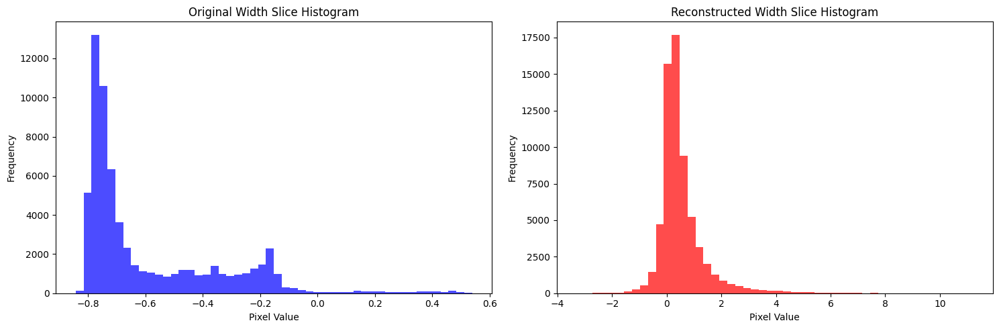

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=63` in the `DataLoader` to improve performance.
/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (14) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

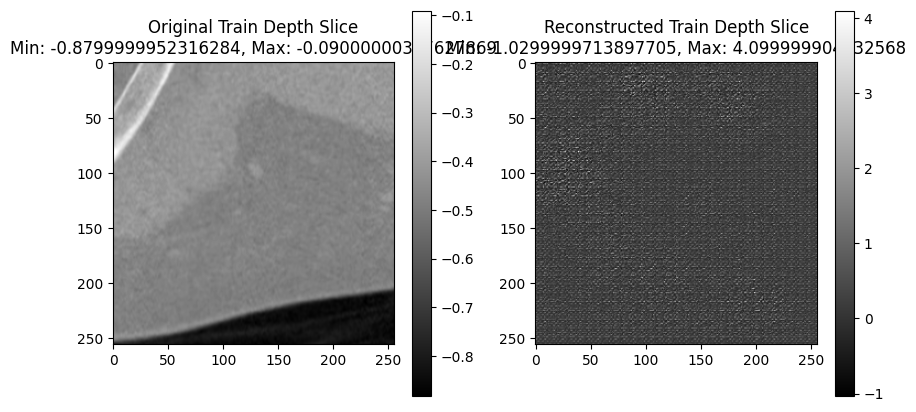

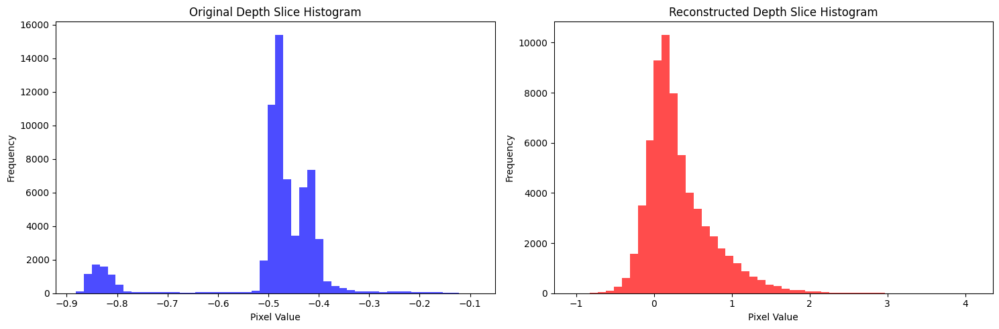

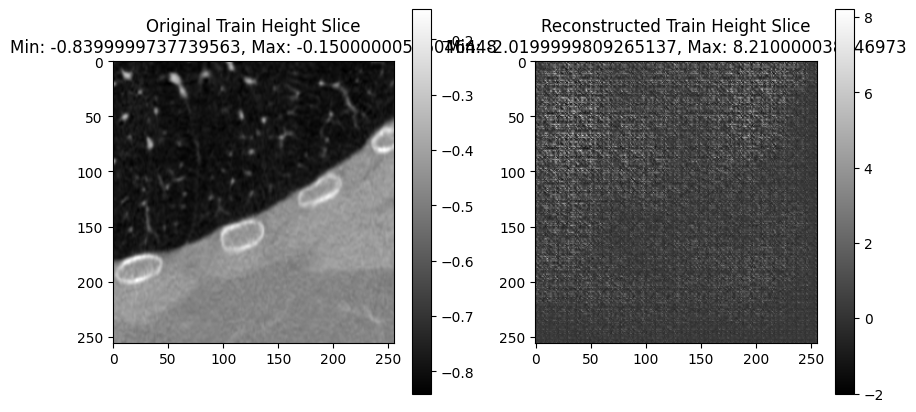

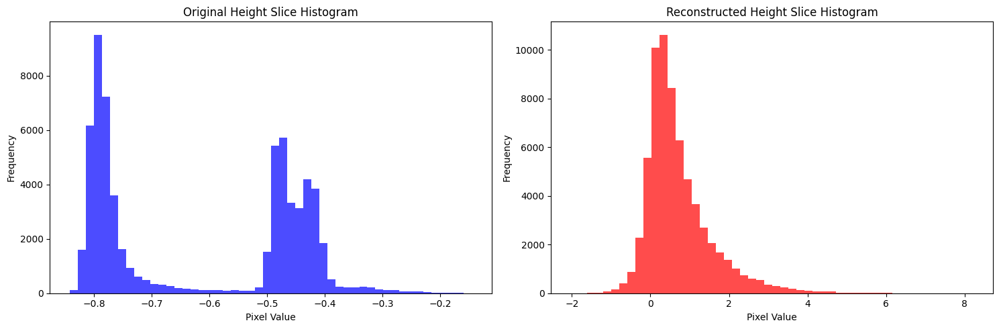

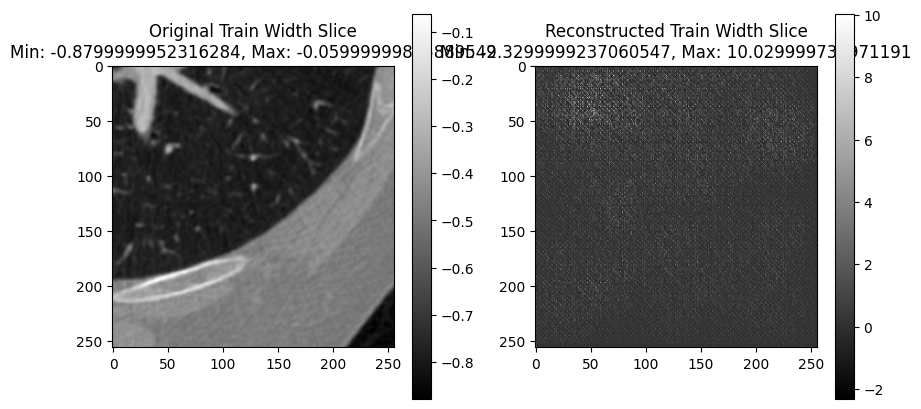

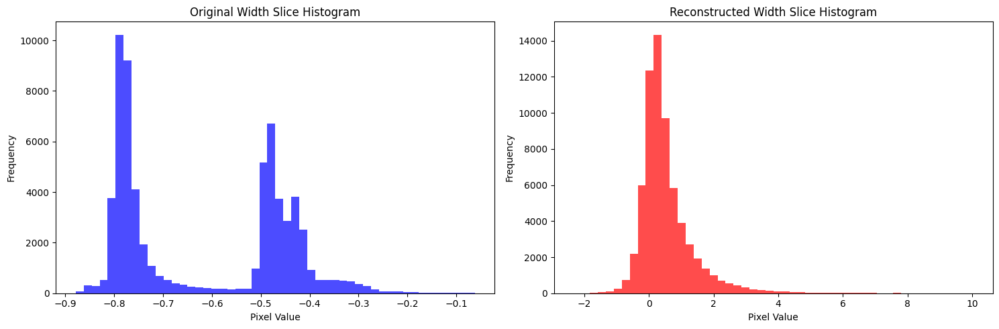

Validation: |          | 0/? [00:00<?, ?it/s]

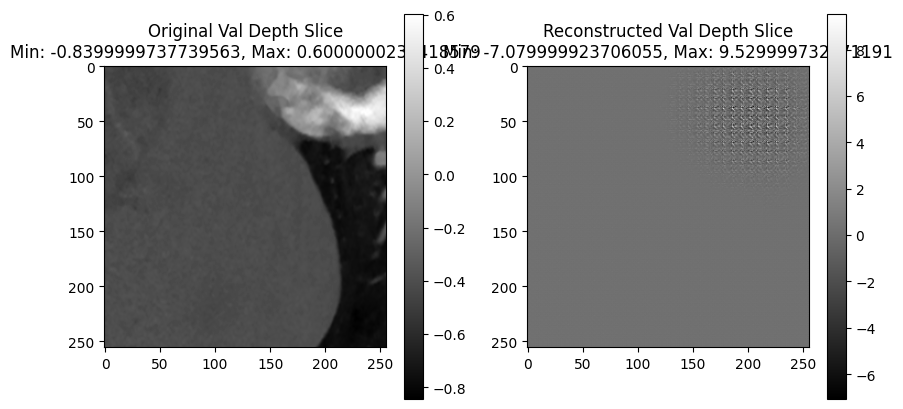

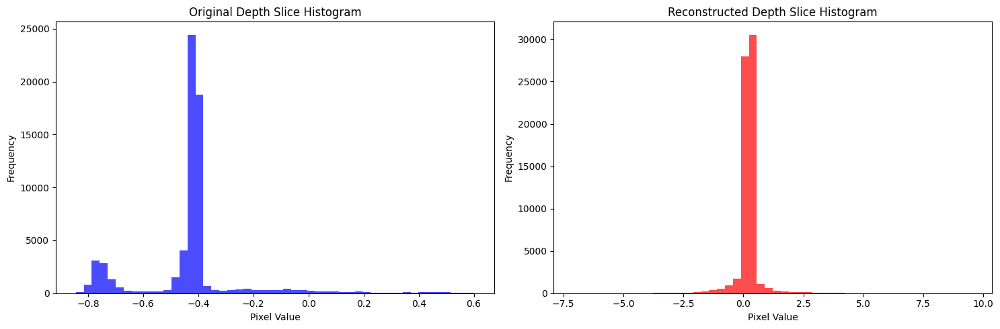

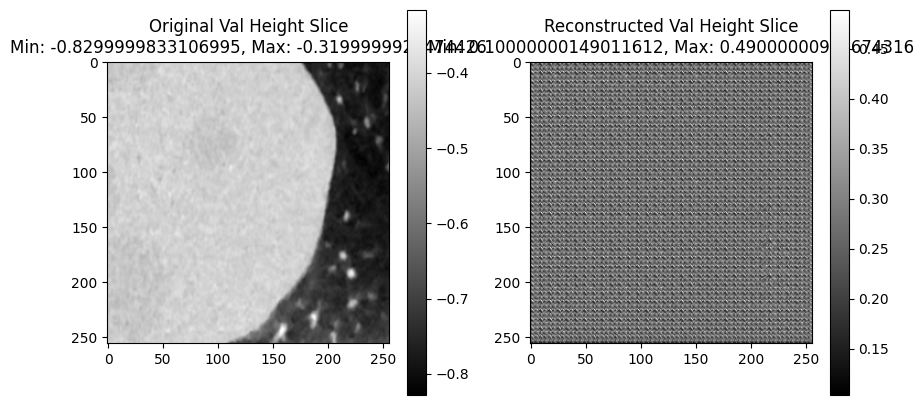

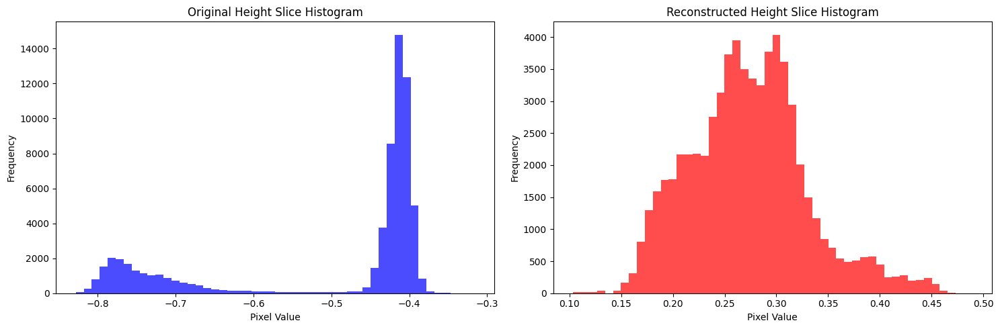

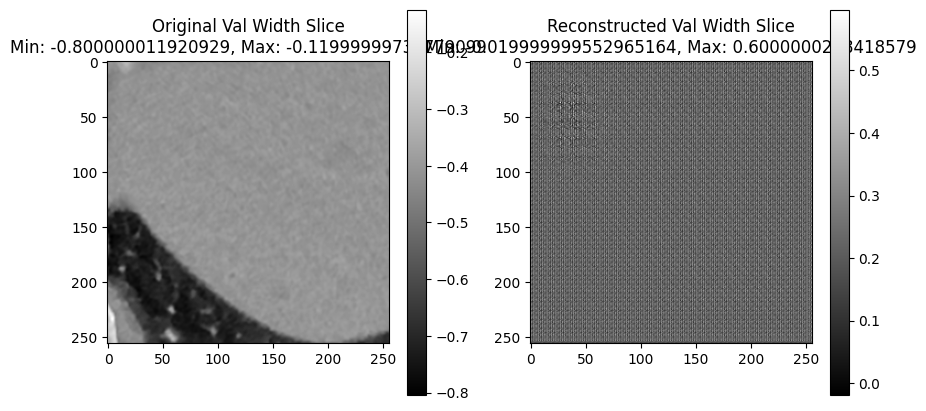

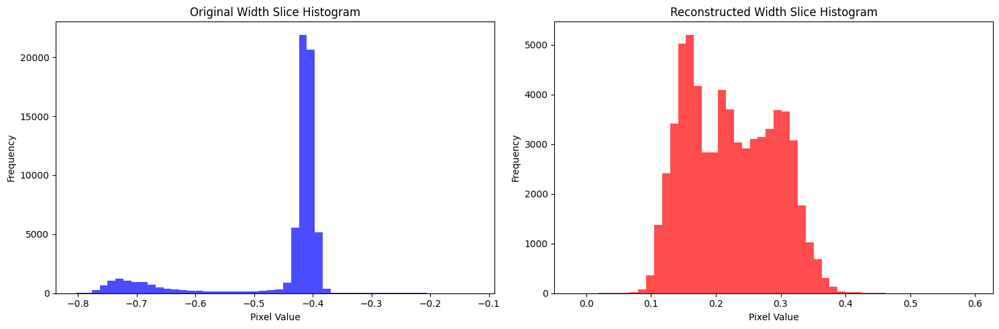

Time Spent 351.33
Epoch: 1


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 363.11
Epoch: 2


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 374.89
Epoch: 3


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 386.80
Epoch: 4


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 398.76
Epoch: 5


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 410.98
Epoch: 6


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 423.20
Epoch: 7


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 435.53
Epoch: 8


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 447.53
Epoch: 9


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 459.27
Epoch: 10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 471.62
Epoch: 11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 483.85
Epoch: 12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 498.31
Epoch: 13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 510.74
Epoch: 14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 523.12
Epoch: 15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 534.89
Epoch: 16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 546.75
Epoch: 17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 559.10
Epoch: 18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 571.38
Epoch: 19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 583.16
Epoch: 20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 594.93
Epoch: 21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 606.95
Epoch: 22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 619.18
Epoch: 23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 631.41
Epoch: 24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 643.79
Epoch: 25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 656.03
Epoch: 26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 668.05
Epoch: 27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 679.78
Epoch: 28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 691.65
Epoch: 29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 703.37
Epoch: 30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 715.14
Epoch: 31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 727.09
Epoch: 32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 738.94
Epoch: 33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 750.70
Epoch: 34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 762.46
Epoch: 35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 774.34
Epoch: 36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 786.22
Epoch: 37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 798.07
Epoch: 38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 809.81
Epoch: 39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 821.66
Epoch: 40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 833.52
Epoch: 41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 845.64
Epoch: 42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 857.80
Epoch: 43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 870.02
Epoch: 44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 881.95
Epoch: 45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 893.71
Epoch: 46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 906.05
Epoch: 47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 917.87
Epoch: 48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 929.59
Epoch: 49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 941.45
Epoch: 50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 953.68
Epoch: 51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 965.90
Epoch: 52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 978.08
Epoch: 53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 990.02
Epoch: 54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1001.78
Epoch: 55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1013.51
Epoch: 56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1025.75
Epoch: 57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1037.76
Epoch: 58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1049.49
Epoch: 59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1061.21
Epoch: 60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1073.61
Epoch: 61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1085.81
Epoch: 62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1097.53
Epoch: 63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1109.23
Epoch: 64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1121.04
Epoch: 65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1132.74
Epoch: 66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1144.45
Epoch: 67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1156.32
Epoch: 68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1168.05
Epoch: 69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1179.75
Epoch: 70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1191.46
Epoch: 71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1203.46
Epoch: 72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1215.24
Epoch: 73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1226.96
Epoch: 74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1238.81
Epoch: 75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1250.54
Epoch: 76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1262.27
Epoch: 77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1274.00
Epoch: 78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1285.83
Epoch: 79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1297.57
Epoch: 80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1309.29
Epoch: 81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1321.02
Epoch: 82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1332.85
Epoch: 83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1344.58
Epoch: 84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1356.35
Epoch: 85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1368.19
Epoch: 86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1380.41
Epoch: 87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1392.65
Epoch: 88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1404.85
Epoch: 89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1417.21
Epoch: 90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1429.09
Epoch: 91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1441.33
Epoch: 92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1453.29
Epoch: 93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1464.99
Epoch: 94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1476.70
Epoch: 95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1488.41
Epoch: 96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1500.22
Epoch: 97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1512.05
Epoch: 98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1523.76
Epoch: 99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1535.59
Epoch: 100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1547.29
Epoch: 101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1559.06
Epoch: 102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1570.83
Epoch: 103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1582.66
Epoch: 104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1594.45
Epoch: 105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1606.21
Epoch: 106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1617.95
Epoch: 107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1629.82
Epoch: 108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1641.78
Epoch: 109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1654.01
Epoch: 110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1666.33
Epoch: 111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1678.55
Epoch: 112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1690.75
Epoch: 113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1702.97
Epoch: 114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1715.54
Epoch: 115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1727.79
Epoch: 116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1740.03
Epoch: 117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1752.06
Epoch: 118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1763.92
Epoch: 119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1775.69
Epoch: 120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1787.41
Epoch: 121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1799.75
Epoch: 122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1811.65
Epoch: 123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1823.42
Epoch: 124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1835.29
Epoch: 125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1847.04
Epoch: 126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1858.77
Epoch: 127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1870.51
Epoch: 128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1882.35
Epoch: 129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1894.11
Epoch: 130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1906.00
Epoch: 131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1917.90
Epoch: 132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1929.75
Epoch: 133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1941.48
Epoch: 134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1953.20
Epoch: 135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1965.05
Epoch: 136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1976.81
Epoch: 137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1988.54
Epoch: 138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2000.77
Epoch: 139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2013.10
Epoch: 140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2025.35
Epoch: 141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2037.58
Epoch: 142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2049.92
Epoch: 143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2062.15
Epoch: 144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2074.38
Epoch: 145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2086.26
Epoch: 146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2098.60
Epoch: 147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2110.42
Epoch: 148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2122.42
Epoch: 149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2134.78
Epoch: 150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2147.26
Epoch: 151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2159.51
Epoch: 152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2171.44
Epoch: 153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2183.29
Epoch: 154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2195.02
Epoch: 155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2206.73
Epoch: 156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2218.46
Epoch: 157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2230.56
Epoch: 158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2242.78
Epoch: 159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2255.00
Epoch: 160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2267.02
Epoch: 161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2278.75
Epoch: 162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2290.71
Epoch: 163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2302.43
Epoch: 164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2314.23
Epoch: 165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2325.94
Epoch: 166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2338.16
Epoch: 167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2350.22
Epoch: 168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2361.96
Epoch: 169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2373.68
Epoch: 170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2385.53
Epoch: 171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2397.46
Epoch: 172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2409.42
Epoch: 173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2421.34
Epoch: 174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2433.20
Epoch: 175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2444.98
Epoch: 176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2456.73
Epoch: 177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2468.68
Epoch: 178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2481.02
Epoch: 179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2492.93
Epoch: 180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2505.15
Epoch: 181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2517.36
Epoch: 182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2529.48
Epoch: 183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2541.39
Epoch: 184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2553.14
Epoch: 185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2564.98
Epoch: 186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2576.71
Epoch: 187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2588.72
Epoch: 188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2600.76
Epoch: 189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2612.80
Epoch: 190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2624.58
Epoch: 191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2636.42
Epoch: 192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2648.76
Epoch: 193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2660.99
Epoch: 194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2673.21
Epoch: 195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2685.42
Epoch: 196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2697.76
Epoch: 197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2709.62
Epoch: 198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2721.35
Epoch: 199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2733.20
Epoch: 200


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2745.70
Epoch: 201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2757.69
Epoch: 202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2769.91
Epoch: 203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2782.24
Epoch: 204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2794.46
Epoch: 205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2806.68
Epoch: 206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2818.91
Epoch: 207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2830.94
Epoch: 208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2843.18
Epoch: 209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2855.50
Epoch: 210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2867.60
Epoch: 211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2879.33
Epoch: 212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2891.05
Epoch: 213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2902.76
Epoch: 214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2914.57
Epoch: 215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2926.31
Epoch: 216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2938.54
Epoch: 217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2950.83
Epoch: 218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2963.04
Epoch: 219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2975.27
Epoch: 220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2987.50
Epoch: 221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2999.86
Epoch: 222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3012.12
Epoch: 223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3023.86
Epoch: 224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3035.72
Epoch: 225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3047.45
Epoch: 226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3059.21
Epoch: 227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3070.94
Epoch: 228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3082.78
Epoch: 229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3095.02
Epoch: 230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3107.23
Epoch: 231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3119.25
Epoch: 232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3131.39
Epoch: 233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3143.62
Epoch: 234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3155.84
Epoch: 235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3167.95
Epoch: 236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3179.72
Epoch: 237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3191.75
Epoch: 238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3203.51
Epoch: 239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3215.40
Epoch: 240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3227.13
Epoch: 241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3238.89
Epoch: 242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3250.77
Epoch: 243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3262.49
Epoch: 244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3277.01
Epoch: 245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3289.23
Epoch: 246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3301.68
Epoch: 247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3313.64
Epoch: 248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3325.71
Epoch: 249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3340.23
Epoch: 250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3354.24
Epoch: 251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3366.21
Epoch: 252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3380.41
Epoch: 253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3396.86
Epoch: 254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3408.62
Epoch: 255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3423.96
Epoch: 256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3436.18
Epoch: 257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3448.51
Epoch: 258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3460.73
Epoch: 259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3472.95
Epoch: 260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3485.28
Epoch: 261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3497.15
Epoch: 262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3508.88
Epoch: 263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3520.85
Epoch: 264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3532.73
Epoch: 265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3544.46
Epoch: 266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3556.57
Epoch: 267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3568.48
Epoch: 268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3580.23
Epoch: 269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3592.15
Epoch: 270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3603.91
Epoch: 271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3616.12
Epoch: 272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3627.89
Epoch: 273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3639.65
Epoch: 274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3651.51
Epoch: 275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3663.24
Epoch: 276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3675.09
Epoch: 277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3686.85
Epoch: 278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3698.71
Epoch: 279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3710.63
Epoch: 280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3722.40
Epoch: 281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3734.17
Epoch: 282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3746.05
Epoch: 283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3757.79
Epoch: 284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3769.72
Epoch: 285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3781.57
Epoch: 286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3793.34
Epoch: 287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3805.06
Epoch: 288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3816.79
Epoch: 289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3828.62
Epoch: 290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3840.40
Epoch: 291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3852.37
Epoch: 292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3865.00
Epoch: 293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3877.22
Epoch: 294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3889.49
Epoch: 295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3901.40
Epoch: 296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3913.27
Epoch: 297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3925.49
Epoch: 298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3937.70
Epoch: 299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3949.74
Epoch: 300


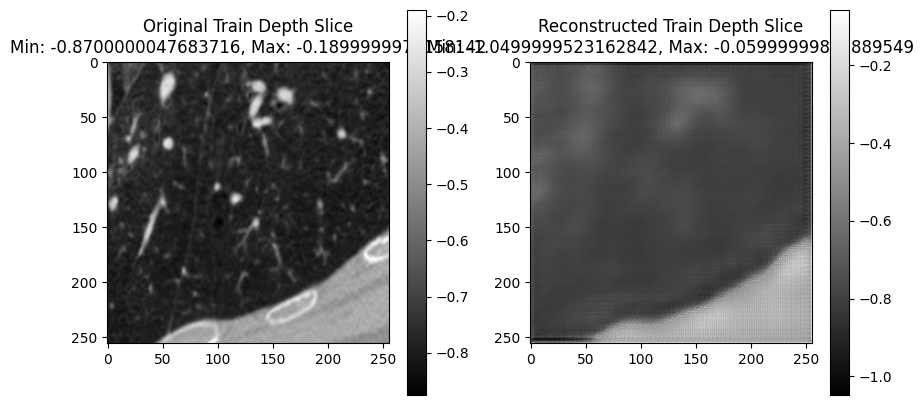

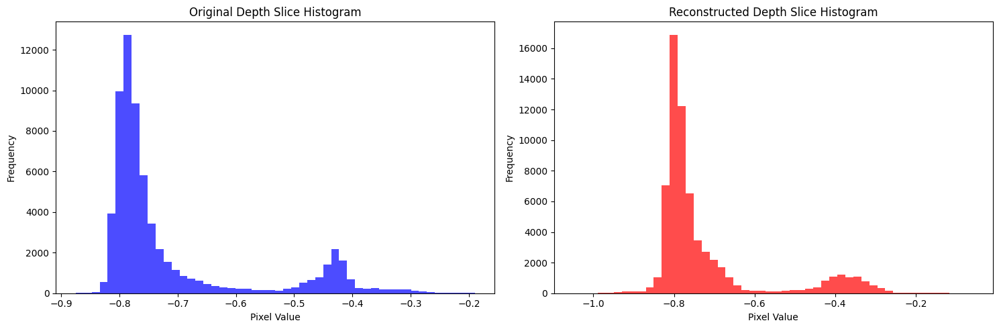

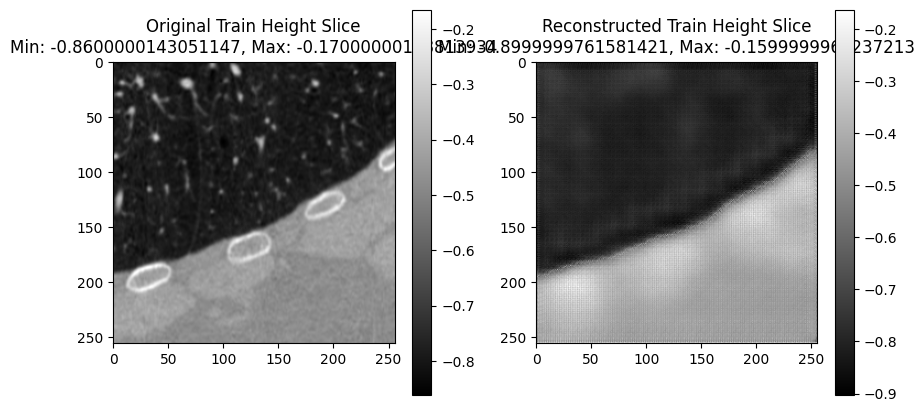

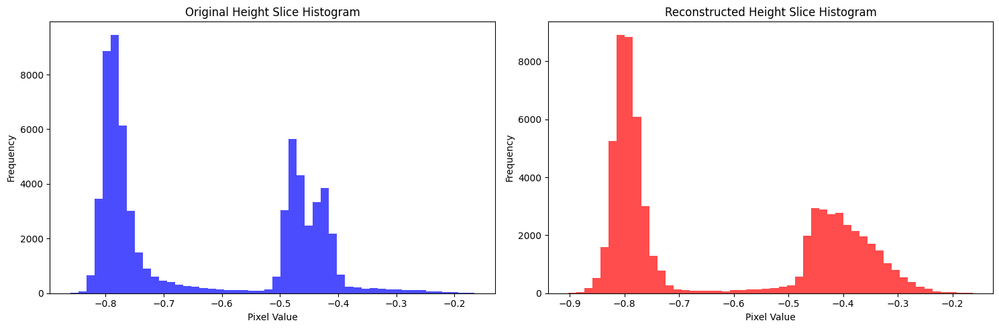

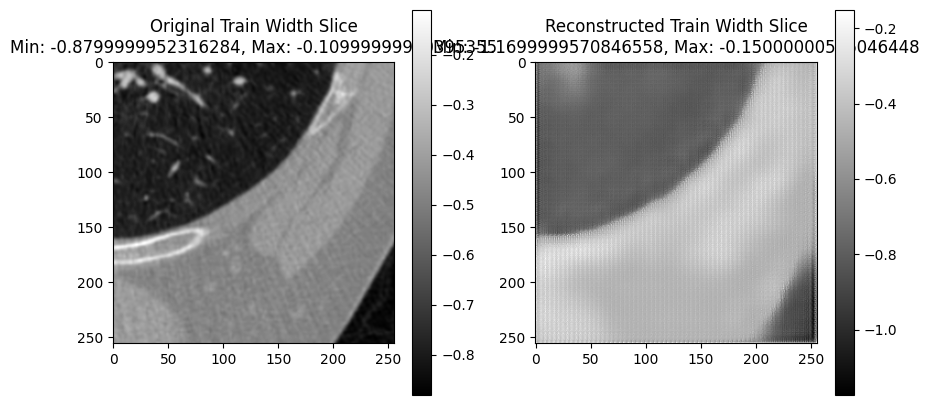

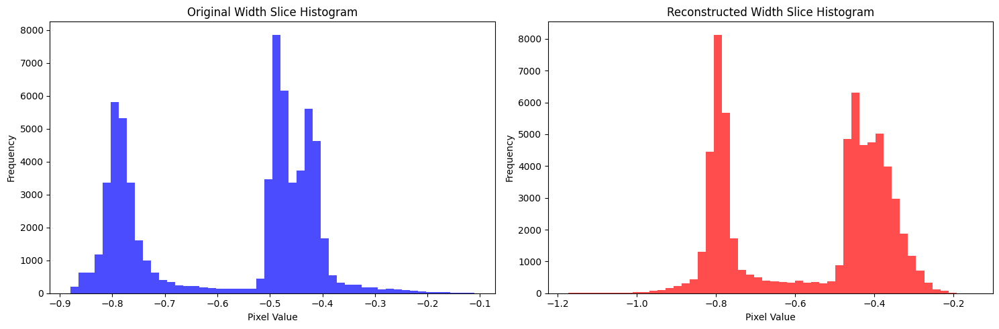

Validation: |          | 0/? [00:00<?, ?it/s]

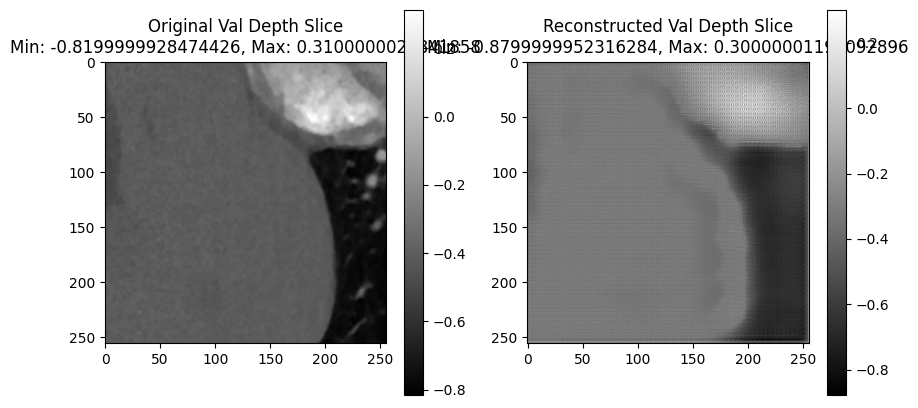

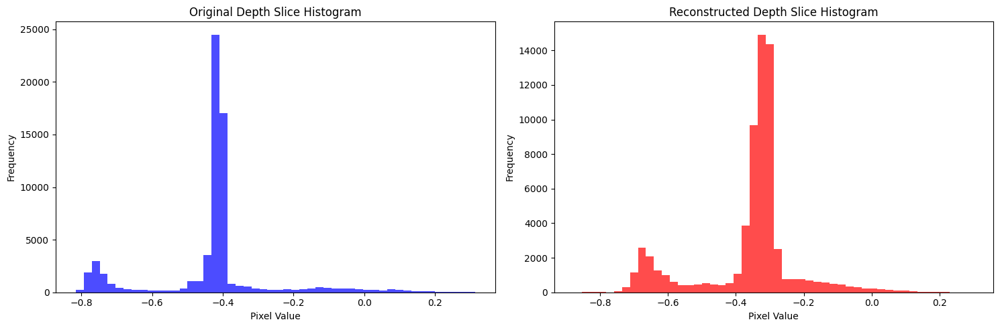

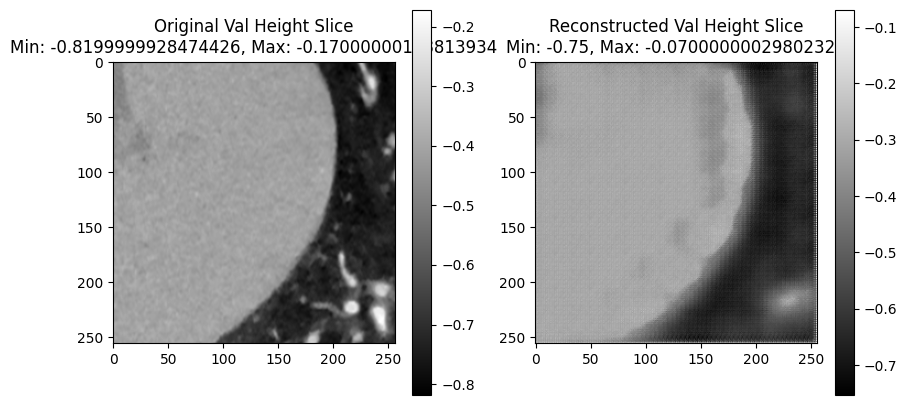

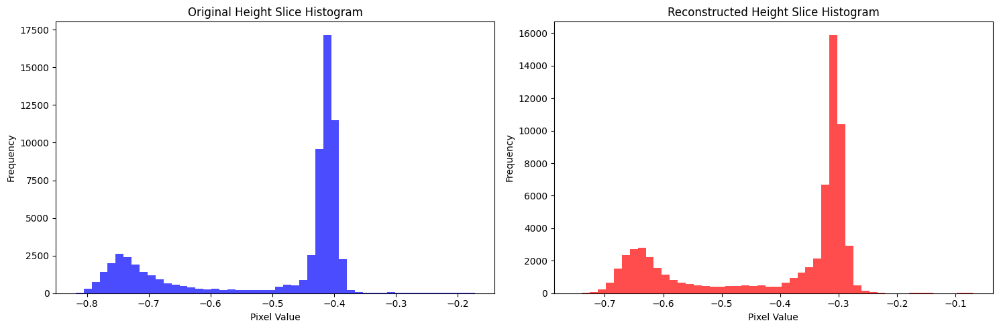

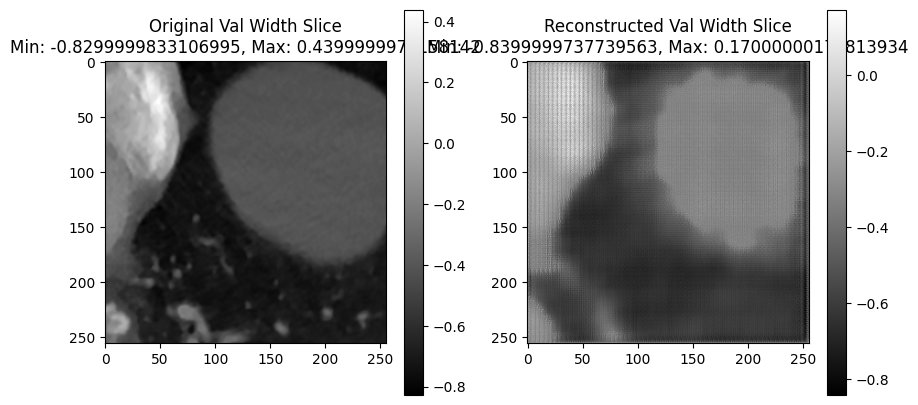

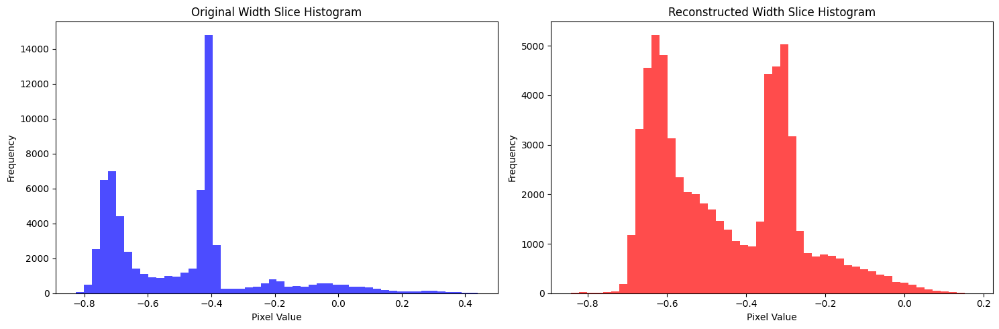

Time Spent 3969.01
Epoch: 301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3980.74
Epoch: 302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3992.47
Epoch: 303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4004.30
Epoch: 304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4016.07
Epoch: 305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4028.00
Epoch: 306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4039.92
Epoch: 307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4051.76
Epoch: 308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4063.52
Epoch: 309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4075.76
Epoch: 310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4088.10
Epoch: 311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4100.44
Epoch: 312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4112.68
Epoch: 313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4124.91
Epoch: 314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4137.24
Epoch: 315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4149.25
Epoch: 316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4161.14
Epoch: 317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4173.50
Epoch: 318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4185.71
Epoch: 319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4197.65
Epoch: 320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4209.64
Epoch: 321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4221.98
Epoch: 322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4234.19
Epoch: 323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4246.07
Epoch: 324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4257.99
Epoch: 325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4269.76
Epoch: 326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4281.51
Epoch: 327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4293.24
Epoch: 328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4305.08
Epoch: 329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4316.82
Epoch: 330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4328.54
Epoch: 331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4340.29
Epoch: 332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4352.12
Epoch: 333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4363.86
Epoch: 334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4375.64
Epoch: 335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4387.70
Epoch: 336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4399.76
Epoch: 337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4411.75
Epoch: 338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4423.48
Epoch: 339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4435.38
Epoch: 340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4447.51
Epoch: 341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4459.73
Epoch: 342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4472.07
Epoch: 343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4484.32
Epoch: 344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4496.51
Epoch: 345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4508.73
Epoch: 346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4521.08
Epoch: 347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4533.31
Epoch: 348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4545.34
Epoch: 349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4557.70
Epoch: 350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4569.68
Epoch: 351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4581.40
Epoch: 352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4593.69
Epoch: 353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4606.01
Epoch: 354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4618.23
Epoch: 355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4630.15
Epoch: 356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4641.88
Epoch: 357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4654.21
Epoch: 358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4666.44
Epoch: 359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4678.66
Epoch: 360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4690.74
Epoch: 361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4702.47
Epoch: 362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4714.19
Epoch: 363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4725.90
Epoch: 364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4737.71
Epoch: 365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4749.42
Epoch: 366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4761.11
Epoch: 367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4773.28
Epoch: 368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4785.61
Epoch: 369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4797.83
Epoch: 370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4810.33
Epoch: 371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4822.20
Epoch: 372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4834.30
Epoch: 373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4846.52
Epoch: 374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4858.86
Epoch: 375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4871.07
Epoch: 376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4883.29
Epoch: 377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4895.51
Epoch: 378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4907.85
Epoch: 379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4919.88
Epoch: 380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4931.93
Epoch: 381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4943.88
Epoch: 382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4956.10
Epoch: 383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4968.32
Epoch: 384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4980.26
Epoch: 385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4992.29
Epoch: 386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5004.53
Epoch: 387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5016.75
Epoch: 388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5028.98
Epoch: 389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5041.06
Epoch: 390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5052.95
Epoch: 391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5064.69
Epoch: 392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5076.55
Epoch: 393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5088.28
Epoch: 394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5100.17
Epoch: 395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5112.08
Epoch: 396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5124.42
Epoch: 397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5136.64
Epoch: 398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5148.87
Epoch: 399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5160.99
Epoch: 400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5173.11
Epoch: 401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5184.85
Epoch: 402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5197.07
Epoch: 403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5209.40
Epoch: 404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5221.33
Epoch: 405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5233.11
Epoch: 406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5244.84
Epoch: 407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5256.67
Epoch: 408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5268.89
Epoch: 409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5281.10
Epoch: 410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5293.05
Epoch: 411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5304.78
Epoch: 412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5316.49
Epoch: 413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5328.19
Epoch: 414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5340.01
Epoch: 415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5352.07
Epoch: 416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5364.29
Epoch: 417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5376.35
Epoch: 418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5388.13
Epoch: 419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5399.87
Epoch: 420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5411.67
Epoch: 421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5423.52
Epoch: 422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5435.24
Epoch: 423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5446.97
Epoch: 424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5458.86
Epoch: 425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5470.63
Epoch: 426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5482.35
Epoch: 427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5494.19
Epoch: 428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5506.52
Epoch: 429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5518.59
Epoch: 430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5530.62
Epoch: 431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5542.83
Epoch: 432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5554.85
Epoch: 433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5567.10
Epoch: 434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5579.33
Epoch: 435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5591.67
Epoch: 436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5603.91
Epoch: 437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5616.14
Epoch: 438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5628.37
Epoch: 439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5640.74
Epoch: 440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5652.96
Epoch: 441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5665.19
Epoch: 442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5677.53
Epoch: 443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5689.76
Epoch: 444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5701.98
Epoch: 445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5714.20
Epoch: 446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5726.21
Epoch: 447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5737.95
Epoch: 448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5749.68
Epoch: 449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5761.54
Epoch: 450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5773.31
Epoch: 451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5785.07
Epoch: 452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5796.84
Epoch: 453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5809.22
Epoch: 454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5821.18
Epoch: 455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5833.02
Epoch: 456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5844.80
Epoch: 457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5856.97
Epoch: 458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5869.19
Epoch: 459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5881.62
Epoch: 460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5894.84
Epoch: 461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5907.08
Epoch: 462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5918.99
Epoch: 463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5930.78
Epoch: 464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5942.65
Epoch: 465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5954.38
Epoch: 466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5966.33
Epoch: 467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5978.68
Epoch: 468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5990.90
Epoch: 469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6002.95
Epoch: 470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6014.85
Epoch: 471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6026.79
Epoch: 472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6038.84
Epoch: 473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6050.57
Epoch: 474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6062.43
Epoch: 475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6074.63
Epoch: 476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6086.86
Epoch: 477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6098.71
Epoch: 478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6110.78
Epoch: 479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6122.53
Epoch: 480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6134.69
Epoch: 481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6146.76
Epoch: 482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6159.20
Epoch: 483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6170.93
Epoch: 484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6182.95
Epoch: 485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6194.91
Epoch: 486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6206.63
Epoch: 487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6218.37
Epoch: 488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6230.10
Epoch: 489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6242.30
Epoch: 490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6254.29
Epoch: 491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6266.03
Epoch: 492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6278.04
Epoch: 493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6289.77
Epoch: 494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6301.50
Epoch: 495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6313.63
Epoch: 496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6326.53
Epoch: 497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6338.97
Epoch: 498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6351.26
Epoch: 499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6363.71
Epoch: 500


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6375.66
Epoch: 501


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6387.75
Epoch: 502


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6399.96
Epoch: 503


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6412.28
Epoch: 504


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6424.51
Epoch: 505


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6436.30
Epoch: 506


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6448.06
Epoch: 507


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6459.95
Epoch: 508


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6471.71
Epoch: 509


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6483.70
Epoch: 510


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6496.00
Epoch: 511


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6507.96
Epoch: 512


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6519.68
Epoch: 513


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6531.39
Epoch: 514


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6543.73
Epoch: 515


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6555.96
Epoch: 516


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6567.70
Epoch: 517


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6579.54
Epoch: 518


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6591.29
Epoch: 519


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6603.01
Epoch: 520


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6615.17
Epoch: 521


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6627.50
Epoch: 522


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6639.70
Epoch: 523


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6651.46
Epoch: 524


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6663.31
Epoch: 525


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6675.45
Epoch: 526


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6687.20
Epoch: 527


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6698.95
Epoch: 528


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6710.79
Epoch: 529


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6722.98
Epoch: 530


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6735.07
Epoch: 531


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6746.81
Epoch: 532


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6758.64
Epoch: 533


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6770.87
Epoch: 534


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6783.09
Epoch: 535


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6795.26
Epoch: 536


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6807.01
Epoch: 537


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6818.75
Epoch: 538


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6830.48
Epoch: 539


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6842.32
Epoch: 540


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6854.04
Epoch: 541


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6865.81
Epoch: 542


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6877.66
Epoch: 543


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6889.40
Epoch: 544


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6901.64
Epoch: 545


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6913.52
Epoch: 546


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6925.41
Epoch: 547


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6937.14
Epoch: 548


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6948.90
Epoch: 549


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6960.76
Epoch: 550


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6972.86
Epoch: 551


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6985.08
Epoch: 552


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6997.30
Epoch: 553


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7009.62
Epoch: 554


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7021.84
Epoch: 555


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7034.05
Epoch: 556


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7046.28
Epoch: 557


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7058.61
Epoch: 558


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7070.83
Epoch: 559


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7083.05
Epoch: 560


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7095.20
Epoch: 561


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7107.42
Epoch: 562


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7119.64
Epoch: 563


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7131.86
Epoch: 564


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7144.21
Epoch: 565


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7156.43
Epoch: 566


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7168.65
Epoch: 567


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7180.76
Epoch: 568


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7192.52
Epoch: 569


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7204.54
Epoch: 570


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7216.56
Epoch: 571


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7228.41
Epoch: 572


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7240.15
Epoch: 573


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7252.16
Epoch: 574


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7264.30
Epoch: 575


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7276.52
Epoch: 576


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7288.73
Epoch: 577


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7300.76
Epoch: 578


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7312.70
Epoch: 579


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7324.47
Epoch: 580


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7336.69
Epoch: 581


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7348.98
Epoch: 582


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7361.11
Epoch: 583


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7372.84
Epoch: 584


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7384.57
Epoch: 585


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7396.44
Epoch: 586


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7408.17
Epoch: 587


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7419.91
Epoch: 588


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7431.94
Epoch: 589


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7444.27
Epoch: 590


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7456.01
Epoch: 591


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7467.72
Epoch: 592


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7480.06
Epoch: 593


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7492.27
Epoch: 594


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7504.48
Epoch: 595


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7516.53
Epoch: 596


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7528.40
Epoch: 597


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7540.14
Epoch: 598


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7552.40
Epoch: 599


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7564.75
Epoch: 600


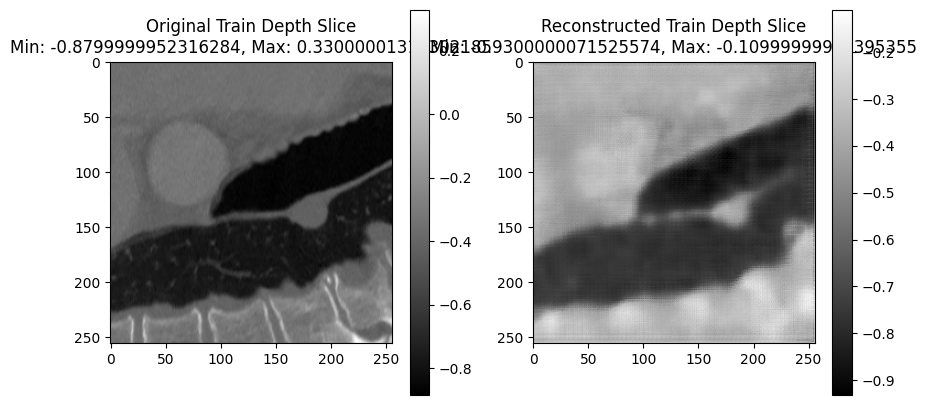

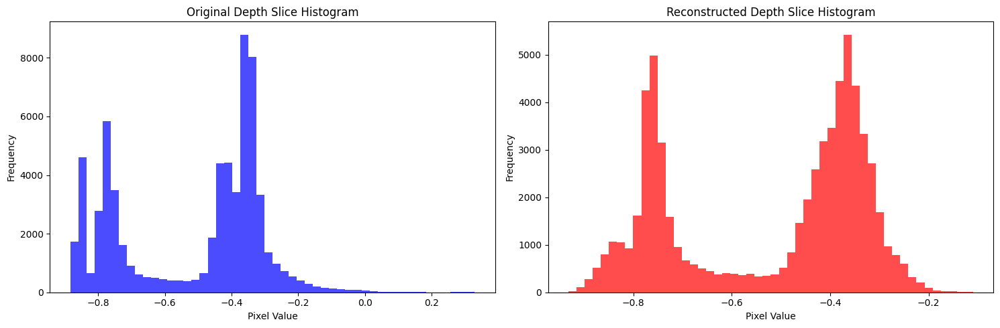

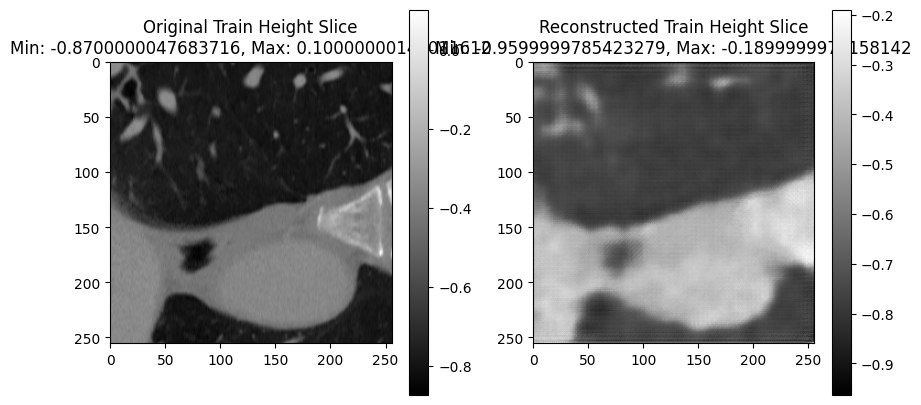

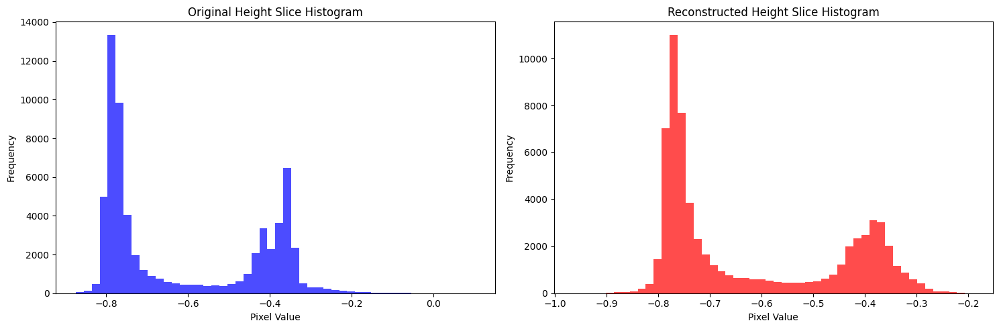

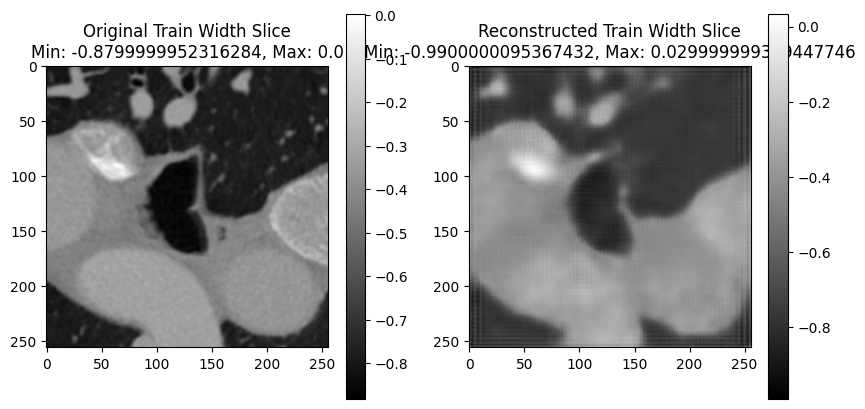

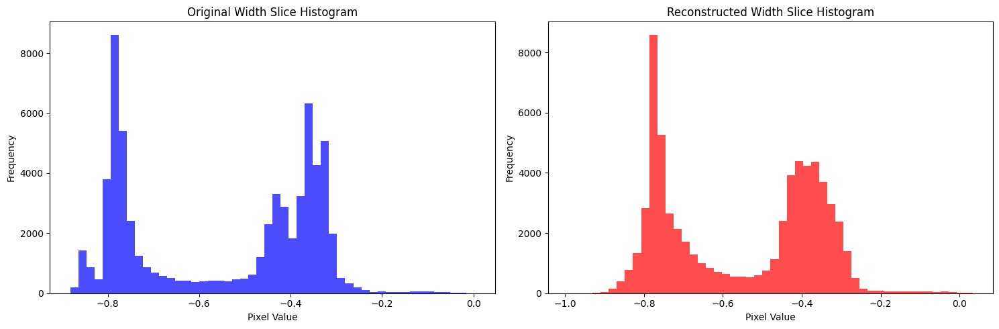

Validation: |          | 0/? [00:00<?, ?it/s]

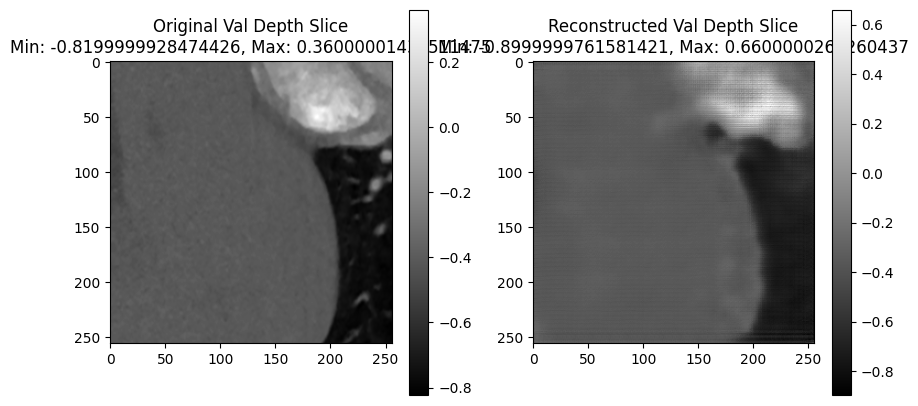

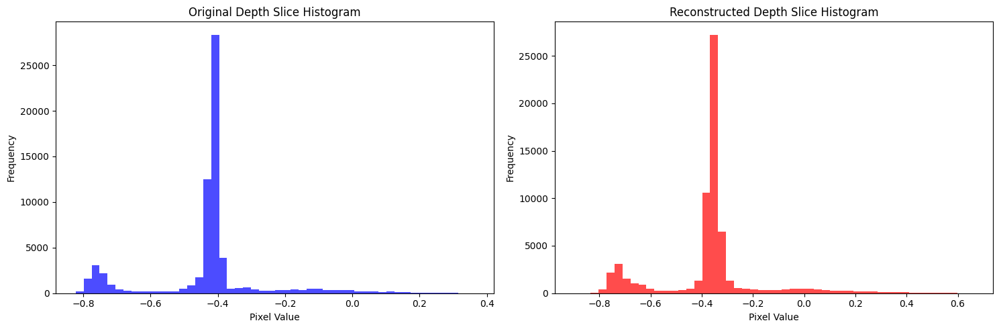

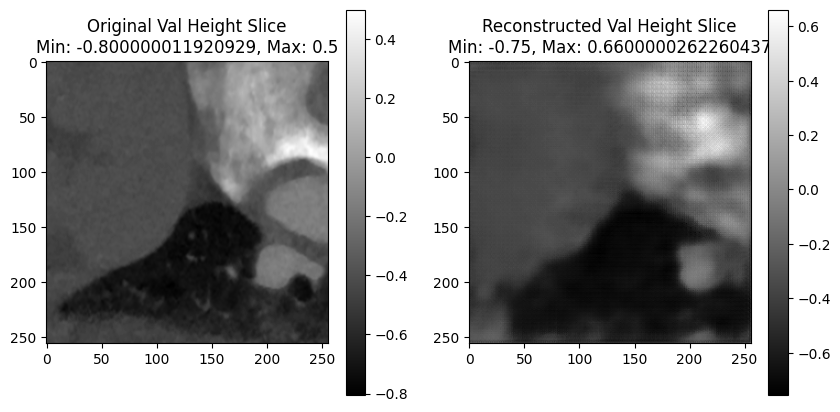

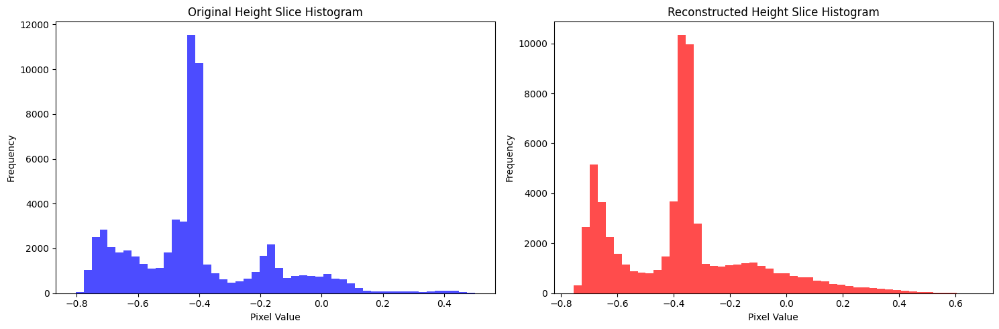

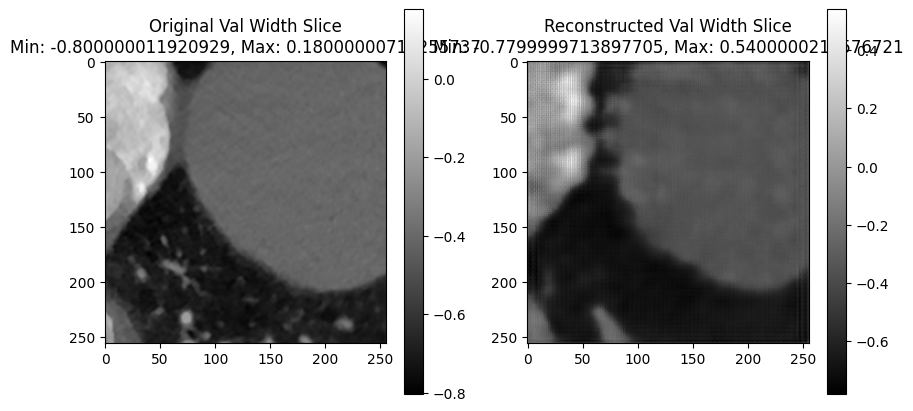

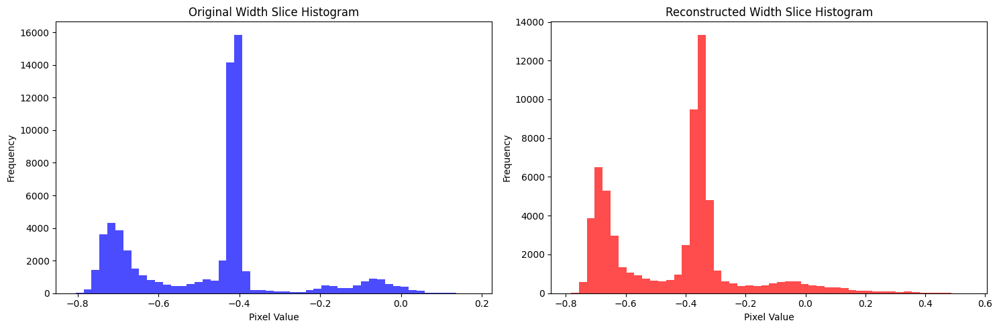

Time Spent 7584.11
Epoch: 601


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7595.91
Epoch: 602


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7607.97
Epoch: 603


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7620.12
Epoch: 604


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7632.17
Epoch: 605


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7644.34
Epoch: 606


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7656.56
Epoch: 607


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7668.90
Epoch: 608


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7681.13
Epoch: 609


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7693.45
Epoch: 610


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7705.59
Epoch: 611


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7717.34
Epoch: 612


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7729.09
Epoch: 613


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7740.84
Epoch: 614


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7753.19
Epoch: 615


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7765.42
Epoch: 616


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7777.63
Epoch: 617


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7789.96
Epoch: 618


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7802.18
Epoch: 619


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7814.38
Epoch: 620


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7826.61
Epoch: 621


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7838.94
Epoch: 622


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7851.16
Epoch: 623


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7863.37
Epoch: 624


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7875.74
Epoch: 625


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7887.53
Epoch: 626


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7899.25
Epoch: 627


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7910.96
Epoch: 628


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7922.80
Epoch: 629


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7935.06
Epoch: 630


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7947.25
Epoch: 631


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7959.01
Epoch: 632


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7970.84
Epoch: 633


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7983.09
Epoch: 634


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7995.02
Epoch: 635


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8006.94
Epoch: 636


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8018.70
Epoch: 637


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8030.47
Epoch: 638


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8042.54
Epoch: 639


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8054.72
Epoch: 640


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8066.45
Epoch: 641


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8078.19
Epoch: 642


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8090.52
Epoch: 643


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8102.72
Epoch: 644


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8114.51
Epoch: 645


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8126.22
Epoch: 646


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8138.77
Epoch: 647


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8151.00
Epoch: 648


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8163.22
Epoch: 649


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8175.33
Epoch: 650


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8187.12
Epoch: 651


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8198.85
Epoch: 652


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8210.61
Epoch: 653


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8222.45
Epoch: 654


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8234.22
Epoch: 655


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8245.98
Epoch: 656


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8257.76
Epoch: 657


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8269.59
Epoch: 658


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8281.32
Epoch: 659


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8293.08
Epoch: 660


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8305.41
Epoch: 661


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8317.63
Epoch: 662


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8329.94
Epoch: 663


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8342.16
Epoch: 664


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8354.48
Epoch: 665


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8366.70
Epoch: 666


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8378.45
Epoch: 667


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8390.28
Epoch: 668


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8402.01
Epoch: 669


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8413.77
Epoch: 670


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8425.51
Epoch: 671


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8437.33
Epoch: 672


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8449.47
Epoch: 673


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8461.55
Epoch: 674


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8473.44
Epoch: 675


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8485.41
Epoch: 676


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8497.63
Epoch: 677


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8509.85
Epoch: 678


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8522.03
Epoch: 679


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8534.17
Epoch: 680


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8546.15
Epoch: 681


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8558.22
Epoch: 682


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8570.05
Epoch: 683


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8581.86
Epoch: 684


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8593.99
Epoch: 685


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8606.33
Epoch: 686


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8618.55
Epoch: 687


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8630.64
Epoch: 688


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8642.38
Epoch: 689


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8654.25
Epoch: 690


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8665.97
Epoch: 691


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8678.19
Epoch: 692


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8690.52
Epoch: 693


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8702.73
Epoch: 694


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8714.94
Epoch: 695


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8727.16
Epoch: 696


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8739.37
Epoch: 697


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8751.11
Epoch: 698


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8763.34
Epoch: 699


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8775.67
Epoch: 700


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8787.89
Epoch: 701


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8799.79
Epoch: 702


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8811.52
Epoch: 703


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8823.36
Epoch: 704


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8835.08
Epoch: 705


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8846.81
Epoch: 706


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8858.54
Epoch: 707


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8870.37
Epoch: 708


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8882.10
Epoch: 709


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8894.20
Epoch: 710


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8906.54
Epoch: 711


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8918.76
Epoch: 712


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8930.99
Epoch: 713


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8943.22
Epoch: 714


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8955.15
Epoch: 715


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8966.92
Epoch: 716


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8978.88
Epoch: 717


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8991.20
Epoch: 718


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9003.41
Epoch: 719


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9015.21
Epoch: 720


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9026.97
Epoch: 721


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9039.33
Epoch: 722


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9051.55
Epoch: 723


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9063.78
Epoch: 724


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9075.71
Epoch: 725


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9087.64
Epoch: 726


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9099.87
Epoch: 727


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9112.09
Epoch: 728


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9124.43
Epoch: 729


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9136.65
Epoch: 730


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9148.87
Epoch: 731


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9161.10
Epoch: 732


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9173.43
Epoch: 733


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9185.65
Epoch: 734


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9197.85
Epoch: 735


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9210.19
Epoch: 736


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9222.43
Epoch: 737


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9234.65
Epoch: 738


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9246.73
Epoch: 739


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9258.58
Epoch: 740


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9270.56
Epoch: 741


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9282.79
Epoch: 742


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9295.12
Epoch: 743


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9307.31
Epoch: 744


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9319.52
Epoch: 745


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9331.73
Epoch: 746


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9344.05
Epoch: 747


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9356.27
Epoch: 748


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9368.49
Epoch: 749


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9380.82
Epoch: 750


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9393.01
Epoch: 751


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9404.75
Epoch: 752


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9416.47
Epoch: 753


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9428.34
Epoch: 754


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9440.07
Epoch: 755


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9451.80
Epoch: 756


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9463.53
Epoch: 757


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9475.87
Epoch: 758


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9488.09
Epoch: 759


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9500.31
Epoch: 760


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9512.65
Epoch: 761


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9524.88
Epoch: 762


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9537.11
Epoch: 763


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9549.15
Epoch: 764


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9561.48
Epoch: 765


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9573.70
Epoch: 766


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9585.93
Epoch: 767


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9598.26
Epoch: 768


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9610.48
Epoch: 769


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9622.26
Epoch: 770


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9634.04
Epoch: 771


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9645.88
Epoch: 772


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9657.65
Epoch: 773


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9669.44
Epoch: 774


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9681.83
Epoch: 775


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9694.05
Epoch: 776


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9706.28
Epoch: 777


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9718.50
Epoch: 778


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9730.55
Epoch: 779


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9742.29
Epoch: 780


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9754.53
Epoch: 781


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9766.76
Epoch: 782


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9779.05
Epoch: 783


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9791.03
Epoch: 784


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9802.78
Epoch: 785


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9814.61
Epoch: 786


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9826.68
Epoch: 787


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9838.62
Epoch: 788


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9850.35
Epoch: 789


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9862.60
Epoch: 790


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9874.82
Epoch: 791


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9887.06
Epoch: 792


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9899.45
Epoch: 793


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9911.23
Epoch: 794


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9923.63
Epoch: 795


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9935.87
Epoch: 796


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9948.23
Epoch: 797


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9960.47
Epoch: 798


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9972.69
Epoch: 799


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9984.54
Epoch: 800


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9996.56
Epoch: 801


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10008.34
Epoch: 802


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10020.09
Epoch: 803


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10032.30
Epoch: 804


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10044.22
Epoch: 805


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10056.58
Epoch: 806


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10068.81
Epoch: 807


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10081.18
Epoch: 808


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10093.39
Epoch: 809


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10105.13
Epoch: 810


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10117.09
Epoch: 811


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10129.31
Epoch: 812


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10141.66
Epoch: 813


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10153.48
Epoch: 814


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10165.34
Epoch: 815


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10177.58
Epoch: 816


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10189.81
Epoch: 817


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10201.90
Epoch: 818


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10213.86
Epoch: 819


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10226.08
Epoch: 820


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10238.30
Epoch: 821


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10250.64
Epoch: 822


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10262.86
Epoch: 823


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10275.09
Epoch: 824


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10287.00
Epoch: 825


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10298.72
Epoch: 826


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10310.43
Epoch: 827


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10322.13
Epoch: 828


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10334.36
Epoch: 829


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10346.58
Epoch: 830


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10358.80
Epoch: 831


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10371.03
Epoch: 832


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10383.47
Epoch: 833


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10395.87
Epoch: 834


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10408.35
Epoch: 835


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10420.90
Epoch: 836


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10433.50
Epoch: 837


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10448.49
Epoch: 838


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10460.82
Epoch: 839


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10473.27
Epoch: 840


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10485.99
Epoch: 841


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10498.24
Epoch: 842


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10511.18
Epoch: 843


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10524.11
Epoch: 844


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10536.56
Epoch: 845


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10548.45
Epoch: 846


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10560.48
Epoch: 847


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10572.78
Epoch: 848


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10585.11
Epoch: 849


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10598.70
Epoch: 850


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10611.14
Epoch: 851


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10623.42
Epoch: 852


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10641.52
Epoch: 853


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10656.69
Epoch: 854


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10670.29
Epoch: 855


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10684.12
Epoch: 856


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10696.06
Epoch: 857


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10707.90
Epoch: 858


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10719.61
Epoch: 859


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10733.89
Epoch: 860


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10745.74
Epoch: 861


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10757.98
Epoch: 862


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10770.25
Epoch: 863


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10782.21
Epoch: 864


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10799.99
Epoch: 865


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10812.30
Epoch: 866


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10824.61
Epoch: 867


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10836.82
Epoch: 868


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10849.71
Epoch: 869


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10861.78
Epoch: 870


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10874.54
Epoch: 871


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10888.06
Epoch: 872


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10900.32
Epoch: 873


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10912.55
Epoch: 874


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10929.18
Epoch: 875


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10946.43
Epoch: 876


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10980.75
Epoch: 877


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10995.88
Epoch: 878


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11008.16
Epoch: 879


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11023.94
Epoch: 880


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11039.18
Epoch: 881


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11085.25
Epoch: 882


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11143.11
Epoch: 883


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11169.66
Epoch: 884


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11184.74
Epoch: 885


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11197.08
Epoch: 886


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11209.31
Epoch: 887


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11221.56
Epoch: 888


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11233.78
Epoch: 889


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11246.10
Epoch: 890


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11258.32
Epoch: 891


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11270.54
Epoch: 892


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11282.87
Epoch: 893


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11295.08
Epoch: 894


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11307.30
Epoch: 895


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11319.13
Epoch: 896


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11330.96
Epoch: 897


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11342.71
Epoch: 898


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11354.70
Epoch: 899


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11366.59
Epoch: 900


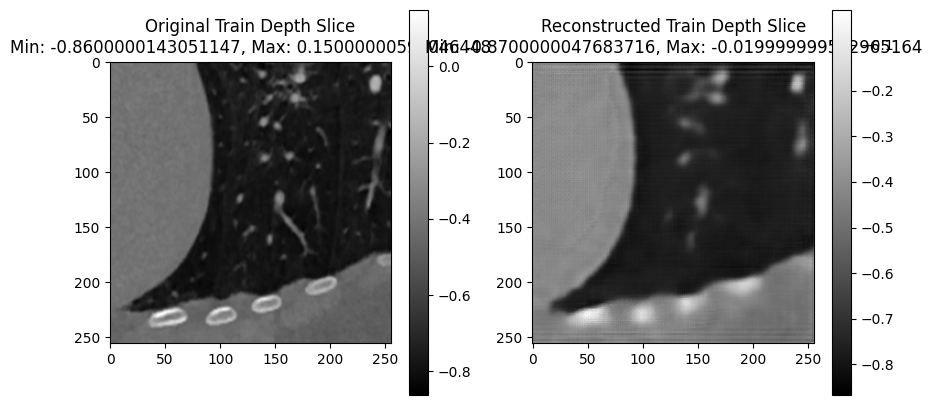

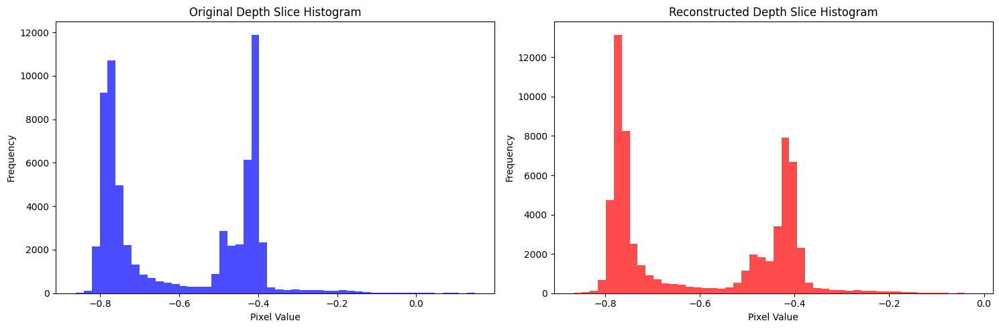

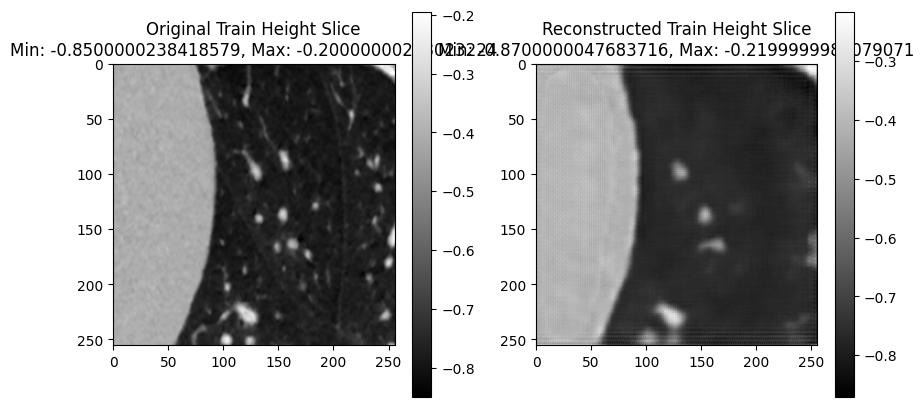

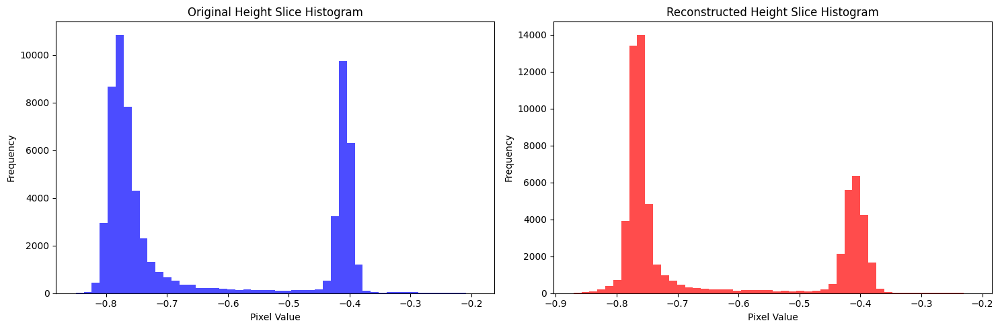

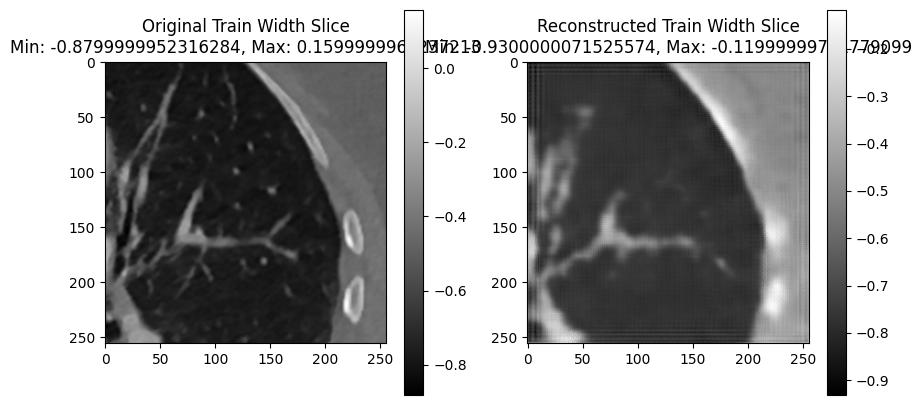

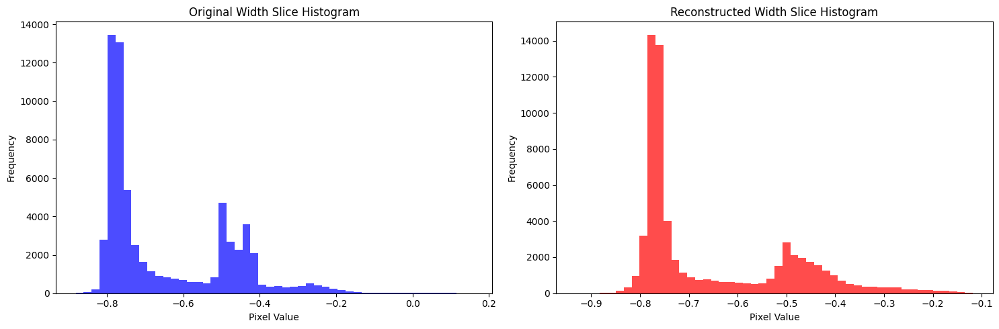

Validation: |          | 0/? [00:00<?, ?it/s]

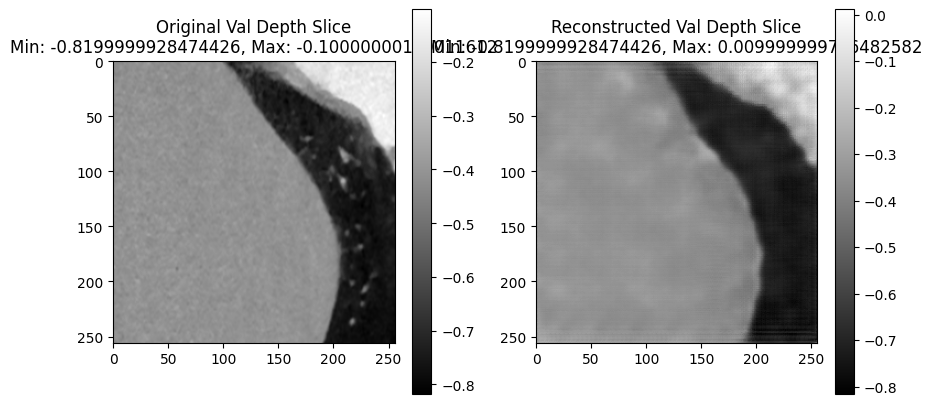

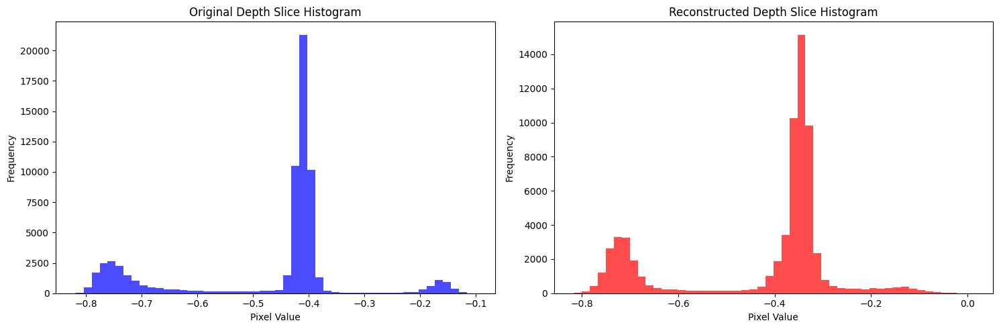

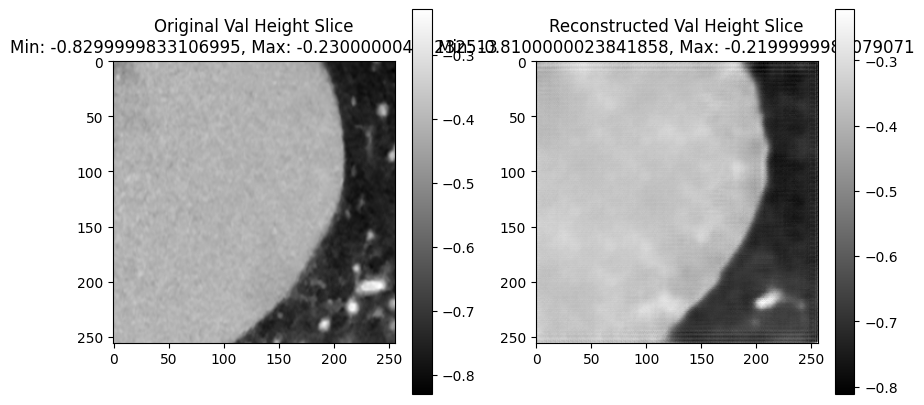

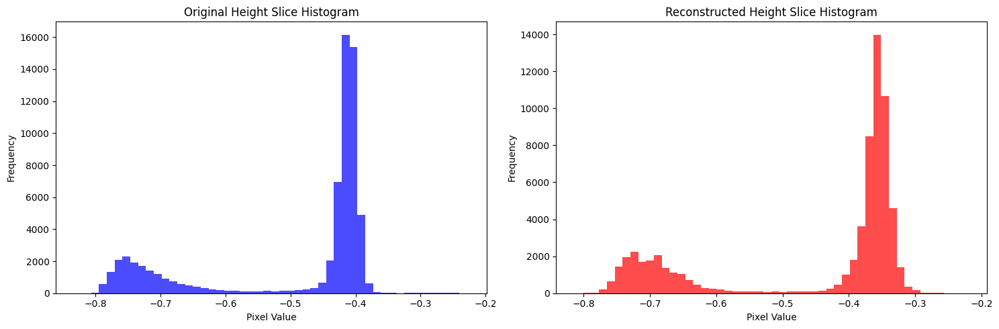

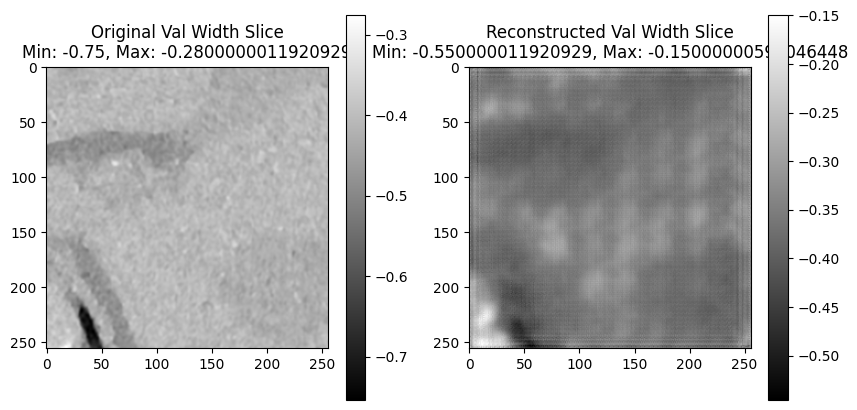

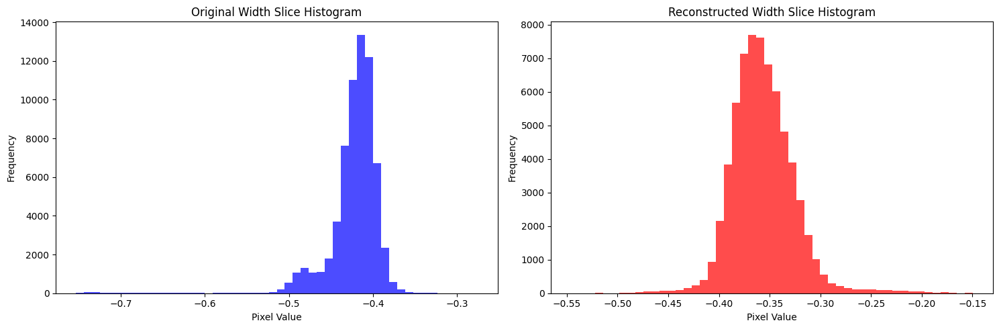

Time Spent 11386.08
Epoch: 901


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11397.80
Epoch: 902


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11410.02
Epoch: 903


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11421.99
Epoch: 904


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11433.74
Epoch: 905


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11445.51
Epoch: 906


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11457.27
Epoch: 907


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11469.42
Epoch: 908


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11481.70
Epoch: 909


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11493.97
Epoch: 910


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11507.04
Epoch: 911


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11519.31
Epoch: 912


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11531.40
Epoch: 913


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11543.16
Epoch: 914


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11555.02
Epoch: 915


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11566.75
Epoch: 916


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11578.78
Epoch: 917


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11590.83
Epoch: 918


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11603.00
Epoch: 919


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11615.00
Epoch: 920


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11626.75
Epoch: 921


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11638.68
Epoch: 922


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11650.55
Epoch: 923


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11662.28
Epoch: 924


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11674.18
Epoch: 925


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11685.95
Epoch: 926


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11697.68
Epoch: 927


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11709.68
Epoch: 928


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11722.03
Epoch: 929


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11734.26
Epoch: 930


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11746.48
Epoch: 931


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11758.70
Epoch: 932


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11770.75
Epoch: 933


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11782.46
Epoch: 934


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11794.17
Epoch: 935


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11805.99
Epoch: 936


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11817.79
Epoch: 937


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11829.75
Epoch: 938


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11841.53
Epoch: 939


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11863.43
Epoch: 940


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11894.51
Epoch: 941


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11934.97
Epoch: 942


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11947.32
Epoch: 943


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11959.55
Epoch: 944


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11971.78
Epoch: 945


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11984.00
Epoch: 946


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11995.90
Epoch: 947


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12007.90
Epoch: 948


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12019.77
Epoch: 949


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12032.14
Epoch: 950


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12044.39
Epoch: 951


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12056.15
Epoch: 952


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12068.09
Epoch: 953


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12080.46
Epoch: 954


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12092.70
Epoch: 955


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12104.96
Epoch: 956


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12117.21
Epoch: 957


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12129.54
Epoch: 958


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12141.78
Epoch: 959


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12153.57
Epoch: 960


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12165.43
Epoch: 961


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12177.22
Epoch: 962


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12188.98
Epoch: 963


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12200.70
Epoch: 964


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12213.06
Epoch: 965


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12225.29
Epoch: 966


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12237.53
Epoch: 967


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12249.42
Epoch: 968


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12261.22
Epoch: 969


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12273.01
Epoch: 970


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12284.76
Epoch: 971


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12296.62
Epoch: 972


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12308.57
Epoch: 973


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12320.51
Epoch: 974


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12332.47
Epoch: 975


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12344.49
Epoch: 976


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12356.92
Epoch: 977


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12369.51
Epoch: 978


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12525.54
Epoch: 979


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12540.82
Epoch: 980


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12555.72
Epoch: 981


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12570.71
Epoch: 982


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12585.80
Epoch: 983


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12601.46
Epoch: 984


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12616.08
Epoch: 985


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12628.42
Epoch: 986


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12640.66
Epoch: 987


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12652.49
Epoch: 988


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12664.27
Epoch: 989


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12676.14
Epoch: 990


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12687.88
Epoch: 991


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12701.36
Epoch: 992


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12713.20
Epoch: 993


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12725.28
Epoch: 994


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12737.50
Epoch: 995


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12749.72
Epoch: 996


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12762.06
Epoch: 997


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12774.02
Epoch: 998


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12786.27
Epoch: 999


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12798.63
Epoch: 1000


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12811.14
Epoch: 1001


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12823.36
Epoch: 1002


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12835.60
Epoch: 1003


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12847.79
Epoch: 1004


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12859.53
Epoch: 1005


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12871.26
Epoch: 1006


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12883.36
Epoch: 1007


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12895.31
Epoch: 1008


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12907.22
Epoch: 1009


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12919.28
Epoch: 1010


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12931.15
Epoch: 1011


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12943.06
Epoch: 1012


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12954.78
Epoch: 1013


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12967.03
Epoch: 1014


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12979.36
Epoch: 1015


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12991.57
Epoch: 1016


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13003.78
Epoch: 1017


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13016.10
Epoch: 1018


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13028.31
Epoch: 1019


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13040.52
Epoch: 1020


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13052.74
Epoch: 1021


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13065.06
Epoch: 1022


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13077.27
Epoch: 1023


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13089.49
Epoch: 1024


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13101.81
Epoch: 1025


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13114.03
Epoch: 1026


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13126.24
Epoch: 1027


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13138.47
Epoch: 1028


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13150.53
Epoch: 1029


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13162.29
Epoch: 1030


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13174.04
Epoch: 1031


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13186.18
Epoch: 1032


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13198.55
Epoch: 1033


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13210.77
Epoch: 1034


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13223.00
Epoch: 1035


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13235.32
Epoch: 1036


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13247.11
Epoch: 1037


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13258.86
Epoch: 1038


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13270.71
Epoch: 1039


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13282.55
Epoch: 1040


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13294.43
Epoch: 1041


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13306.19
Epoch: 1042


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13318.04
Epoch: 1043


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13329.77
Epoch: 1044


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13341.50
Epoch: 1045


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13353.73
Epoch: 1046


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13366.07
Epoch: 1047


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13378.31
Epoch: 1048


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13390.39
Epoch: 1049


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13402.46
Epoch: 1050


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13414.44
Epoch: 1051


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13426.19
Epoch: 1052


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13437.92
Epoch: 1053


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13450.22
Epoch: 1054


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13462.45
Epoch: 1055


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13474.67
Epoch: 1056


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13486.88
Epoch: 1057


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13499.22
Epoch: 1058


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13511.19
Epoch: 1059


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13522.95
Epoch: 1060


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13534.78
Epoch: 1061


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13546.55
Epoch: 1062


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13558.28
Epoch: 1063


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13570.31
Epoch: 1064


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13582.32
Epoch: 1065


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13594.05
Epoch: 1066


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13605.77
Epoch: 1067


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13617.63
Epoch: 1068


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13629.88
Epoch: 1069


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13641.79
Epoch: 1070


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13653.51
Epoch: 1071


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13665.87
Epoch: 1072


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13678.09
Epoch: 1073


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13690.05
Epoch: 1074


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13701.88
Epoch: 1075


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13713.58
Epoch: 1076


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13725.32
Epoch: 1077


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13737.09
Epoch: 1078


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13749.23
Epoch: 1079


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13761.16
Epoch: 1080


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13772.91
Epoch: 1081


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13784.81
Epoch: 1082


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13796.84
Epoch: 1083


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13809.08
Epoch: 1084


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13821.30
Epoch: 1085


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13833.33
Epoch: 1086


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13845.24
Epoch: 1087


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13857.47
Epoch: 1088


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13869.69
Epoch: 1089


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13882.01
Epoch: 1090


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13893.91
Epoch: 1091


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13905.64
Epoch: 1092


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13917.47
Epoch: 1093


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13929.24
Epoch: 1094


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13941.01
Epoch: 1095


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13952.74
Epoch: 1096


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13964.60
Epoch: 1097


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13976.33
Epoch: 1098


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13988.24
Epoch: 1099


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14000.58
Epoch: 1100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14012.51
Epoch: 1101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14024.25
Epoch: 1102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14036.47
Epoch: 1103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14048.57
Epoch: 1104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14060.29
Epoch: 1105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14072.04
Epoch: 1106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14083.77
Epoch: 1107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14096.11
Epoch: 1108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14108.14
Epoch: 1109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14120.37
Epoch: 1110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14132.70
Epoch: 1111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14144.93
Epoch: 1112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14157.15
Epoch: 1113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14169.14
Epoch: 1114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14181.59
Epoch: 1115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14193.79
Epoch: 1116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14206.02
Epoch: 1117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14218.08
Epoch: 1118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14230.04
Epoch: 1119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14242.26
Epoch: 1120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14254.47
Epoch: 1121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14266.80
Epoch: 1122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14278.76
Epoch: 1123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14290.54
Epoch: 1124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14302.90
Epoch: 1125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14315.10
Epoch: 1126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14327.18
Epoch: 1127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14338.91
Epoch: 1128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14350.98
Epoch: 1129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14362.71
Epoch: 1130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14374.44
Epoch: 1131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14386.17
Epoch: 1132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14398.02
Epoch: 1133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14409.74
Epoch: 1134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14421.96
Epoch: 1135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14434.29
Epoch: 1136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14446.51
Epoch: 1137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14458.72
Epoch: 1138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14470.94
Epoch: 1139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14483.01
Epoch: 1140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14494.74
Epoch: 1141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14506.97
Epoch: 1142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14519.30
Epoch: 1143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14531.23
Epoch: 1144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14543.01
Epoch: 1145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14555.13
Epoch: 1146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14567.03
Epoch: 1147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14578.78
Epoch: 1148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14590.84
Epoch: 1149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14603.20
Epoch: 1150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14615.12
Epoch: 1151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14626.85
Epoch: 1152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14638.58
Epoch: 1153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14650.46
Epoch: 1154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14662.19
Epoch: 1155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14673.95
Epoch: 1156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14685.71
Epoch: 1157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14697.57
Epoch: 1158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14709.53
Epoch: 1159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14721.75
Epoch: 1160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14734.08
Epoch: 1161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14746.29
Epoch: 1162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14758.52
Epoch: 1163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14770.49
Epoch: 1164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14782.58
Epoch: 1165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14794.51
Epoch: 1166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14806.25
Epoch: 1167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14818.44
Epoch: 1168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14830.39
Epoch: 1169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14842.15
Epoch: 1170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14853.89
Epoch: 1171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14865.72
Epoch: 1172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14877.46
Epoch: 1173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14889.44
Epoch: 1174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14901.78
Epoch: 1175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14913.73
Epoch: 1176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14925.84
Epoch: 1177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14938.06
Epoch: 1178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14950.17
Epoch: 1179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14961.93
Epoch: 1180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14974.20
Epoch: 1181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14986.44
Epoch: 1182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 14998.80
Epoch: 1183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15010.75
Epoch: 1184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15022.49
Epoch: 1185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15034.34
Epoch: 1186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15046.12
Epoch: 1187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15058.03
Epoch: 1188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15070.26
Epoch: 1189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15082.33
Epoch: 1190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15094.07
Epoch: 1191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15105.79
Epoch: 1192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15117.92
Epoch: 1193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15129.94
Epoch: 1194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15142.17
Epoch: 1195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15154.40
Epoch: 1196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15166.72
Epoch: 1197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15178.95
Epoch: 1198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15190.96
Epoch: 1199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15203.21
Epoch: 1200


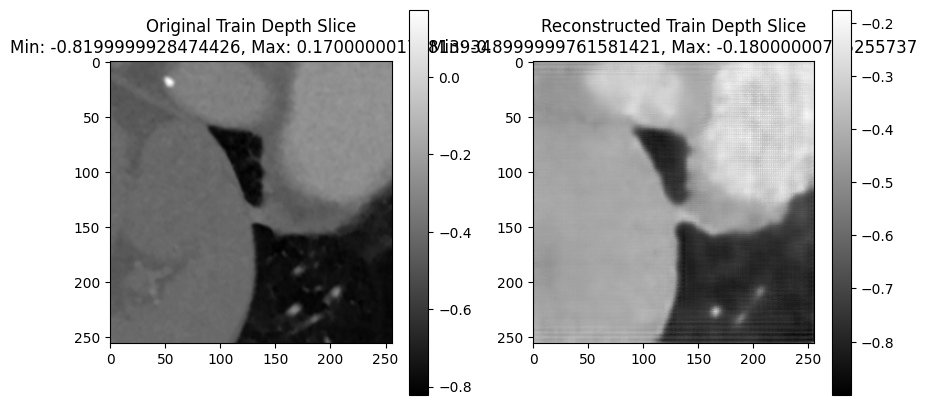

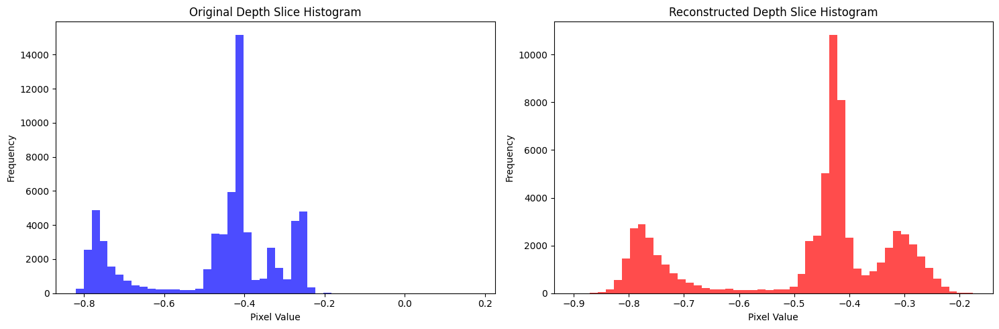

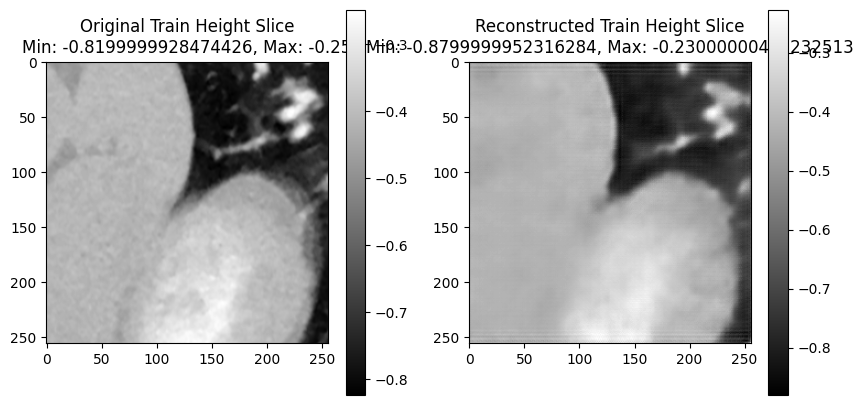

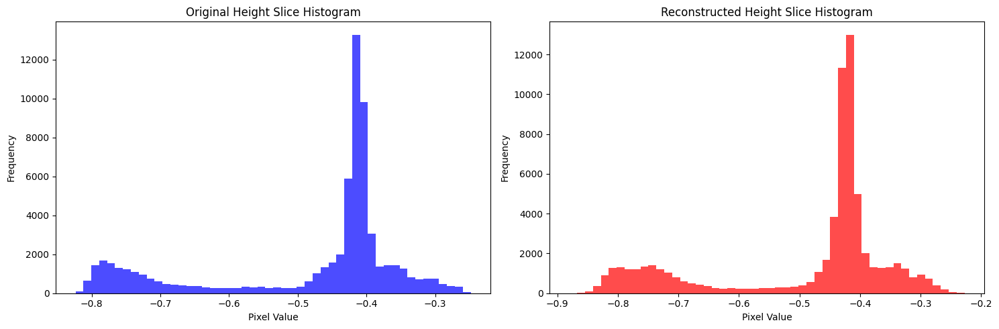

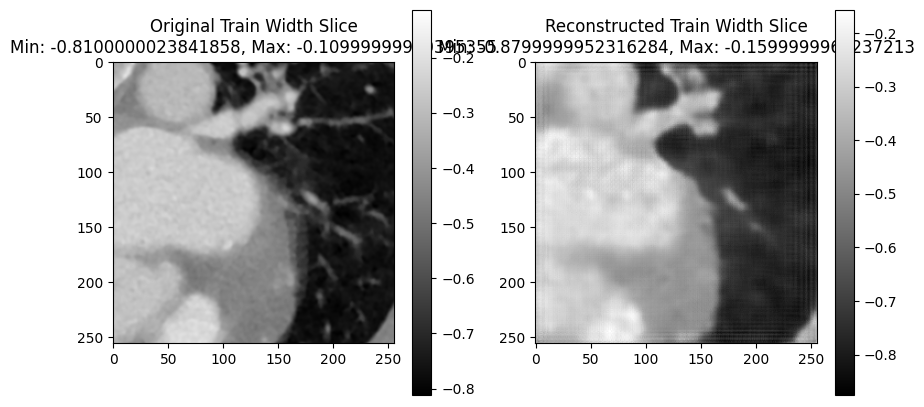

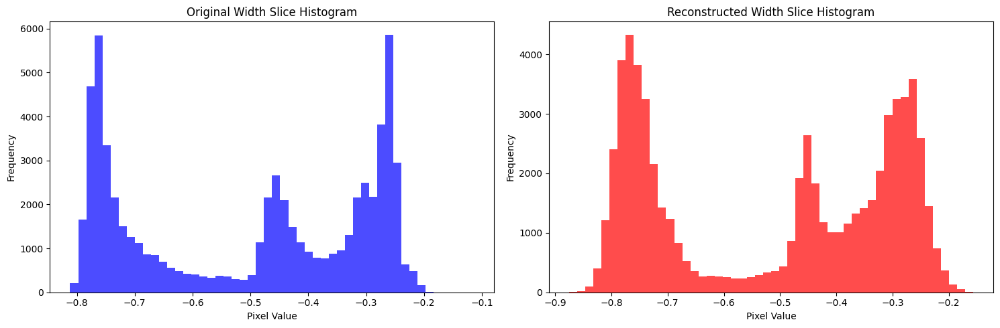

Validation: |          | 0/? [00:00<?, ?it/s]

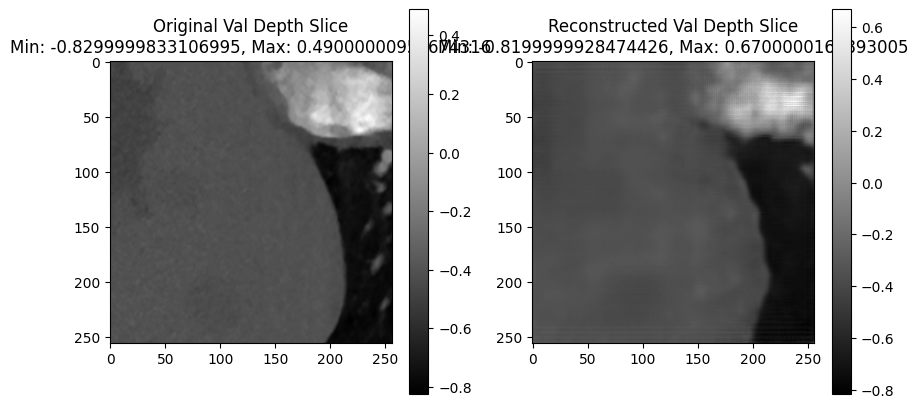

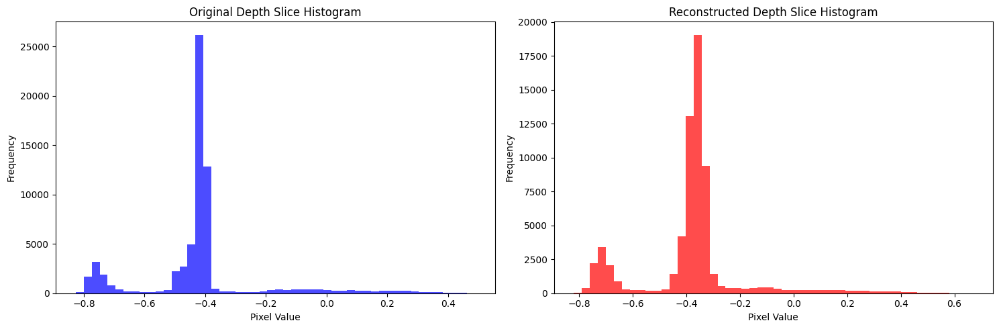

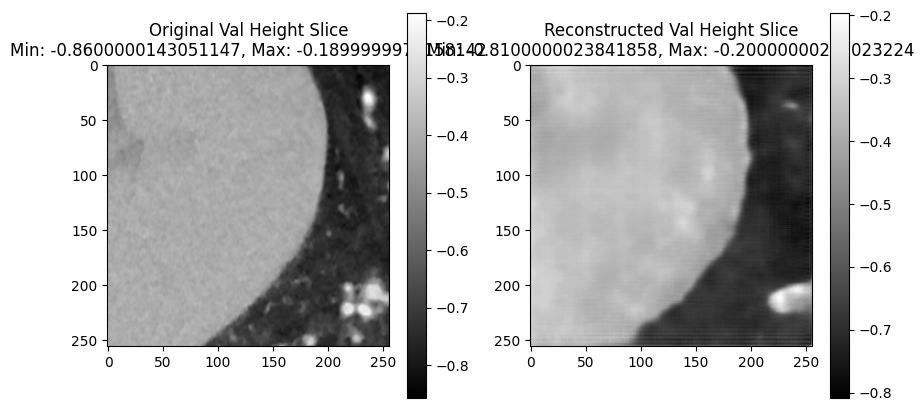

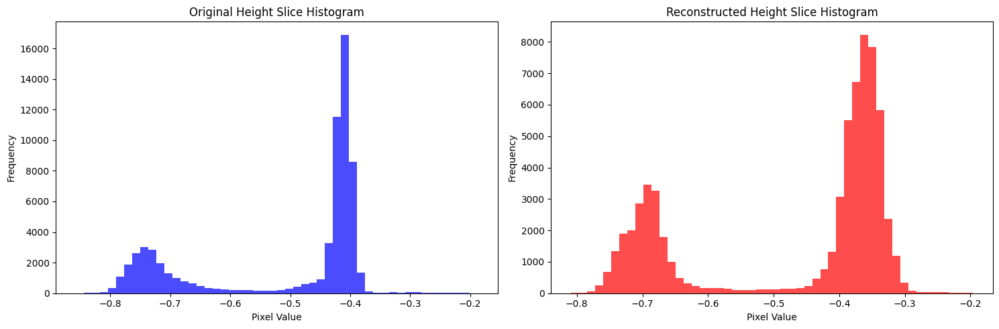

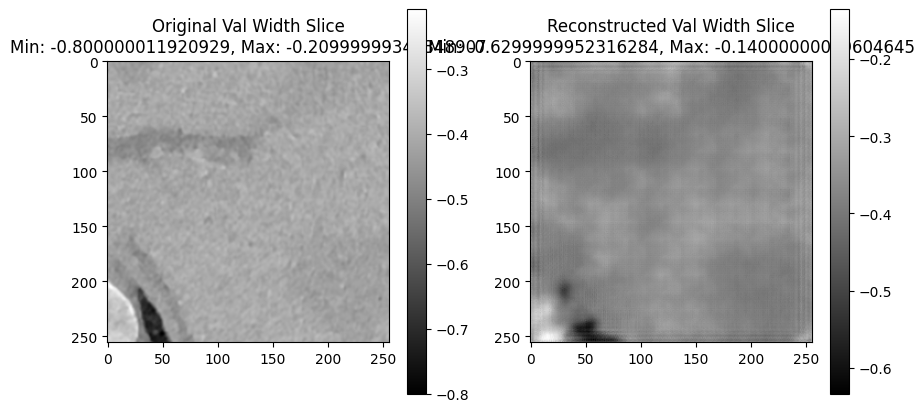

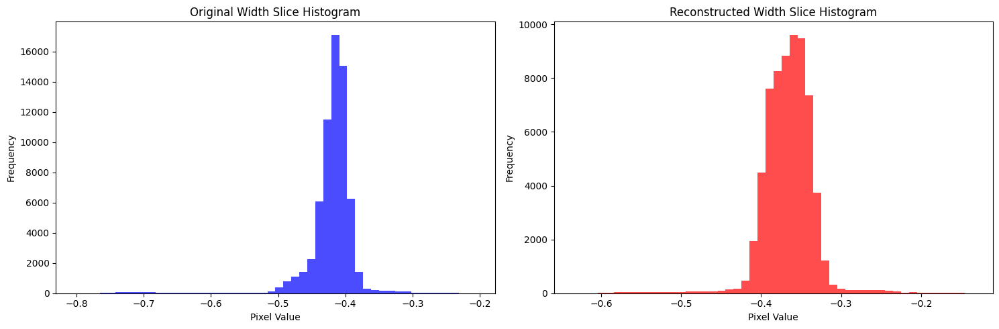

Time Spent 15222.37
Epoch: 1201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15234.32
Epoch: 1202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15246.58
Epoch: 1203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15258.43
Epoch: 1204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15270.66
Epoch: 1205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15282.89
Epoch: 1206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15294.62
Epoch: 1207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15306.43
Epoch: 1208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15318.22
Epoch: 1209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15329.95
Epoch: 1210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15341.79
Epoch: 1211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15353.53
Epoch: 1212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15365.64
Epoch: 1213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15377.89
Epoch: 1214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15390.25
Epoch: 1215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15402.47
Epoch: 1216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15414.76
Epoch: 1217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15426.92
Epoch: 1218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15438.65
Epoch: 1219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15450.37
Epoch: 1220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15462.14
Epoch: 1221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15473.98
Epoch: 1222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15485.99
Epoch: 1223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15498.24
Epoch: 1224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15510.58
Epoch: 1225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15522.60
Epoch: 1226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15534.36
Epoch: 1227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15546.14
Epoch: 1228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15558.37
Epoch: 1229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15570.15
Epoch: 1230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15581.89
Epoch: 1231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15593.62
Epoch: 1232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15605.97
Epoch: 1233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15618.19
Epoch: 1234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15630.41
Epoch: 1235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15642.80
Epoch: 1236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15655.03
Epoch: 1237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15667.26
Epoch: 1238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15679.48
Epoch: 1239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15691.83
Epoch: 1240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15704.05
Epoch: 1241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15716.27
Epoch: 1242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15728.59
Epoch: 1243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15740.81
Epoch: 1244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15753.04
Epoch: 1245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15765.25
Epoch: 1246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15777.57
Epoch: 1247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15789.78
Epoch: 1248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15802.02
Epoch: 1249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15814.37
Epoch: 1250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15826.59
Epoch: 1251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15838.81
Epoch: 1252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15850.77
Epoch: 1253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15862.62
Epoch: 1254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15874.85
Epoch: 1255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15887.07
Epoch: 1256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15899.29
Epoch: 1257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15911.31
Epoch: 1258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15923.57
Epoch: 1259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15935.79
Epoch: 1260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15948.16
Epoch: 1261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15960.20
Epoch: 1262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15971.94
Epoch: 1263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15983.68
Epoch: 1264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 15995.55
Epoch: 1265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16007.29
Epoch: 1266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16019.03
Epoch: 1267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16031.18
Epoch: 1268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16043.40
Epoch: 1269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16055.63
Epoch: 1270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16067.86
Epoch: 1271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16080.19
Epoch: 1272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16092.10
Epoch: 1273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16103.83
Epoch: 1274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16115.68
Epoch: 1275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16127.44
Epoch: 1276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16139.17
Epoch: 1277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16151.23
Epoch: 1278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16163.58
Epoch: 1279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16175.80
Epoch: 1280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16188.04
Epoch: 1281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16200.34
Epoch: 1282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16212.40
Epoch: 1283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16224.14
Epoch: 1284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16236.15
Epoch: 1285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16248.49
Epoch: 1286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16260.51
Epoch: 1287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16272.47
Epoch: 1288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16284.69
Epoch: 1289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16297.02
Epoch: 1290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16309.24
Epoch: 1291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16321.26
Epoch: 1292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16333.12
Epoch: 1293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16344.88
Epoch: 1294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16357.14
Epoch: 1295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16369.34
Epoch: 1296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16381.19
Epoch: 1297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16393.00
Epoch: 1298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16404.73
Epoch: 1299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16417.09
Epoch: 1300


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16429.31
Epoch: 1301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16441.53
Epoch: 1302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16453.39
Epoch: 1303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16465.23
Epoch: 1304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16476.95
Epoch: 1305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16489.19
Epoch: 1306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16501.20
Epoch: 1307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16513.32
Epoch: 1308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16525.06
Epoch: 1309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16536.80
Epoch: 1310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16548.64
Epoch: 1311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16560.36
Epoch: 1312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16572.18
Epoch: 1313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16583.92
Epoch: 1314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16595.76
Epoch: 1315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16607.54
Epoch: 1316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16619.26
Epoch: 1317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16631.42
Epoch: 1318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16643.65
Epoch: 1319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16655.66
Epoch: 1320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16667.41
Epoch: 1321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16679.26
Epoch: 1322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16691.08
Epoch: 1323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16702.81
Epoch: 1324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16714.67
Epoch: 1325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16726.91
Epoch: 1326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16739.13
Epoch: 1327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16751.37
Epoch: 1328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16763.70
Epoch: 1329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16775.94
Epoch: 1330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16788.17
Epoch: 1331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16800.22
Epoch: 1332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16812.51
Epoch: 1333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16824.74
Epoch: 1334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16836.75
Epoch: 1335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16848.61
Epoch: 1336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16860.35
Epoch: 1337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16872.44
Epoch: 1338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16884.67
Epoch: 1339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16896.81
Epoch: 1340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16908.58
Epoch: 1341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16920.80
Epoch: 1342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16933.14
Epoch: 1343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16945.42
Epoch: 1344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16957.64
Epoch: 1345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16969.85
Epoch: 1346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16982.21
Epoch: 1347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 16994.14
Epoch: 1348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17006.38
Epoch: 1349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17018.33
Epoch: 1350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17030.12
Epoch: 1351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17042.18
Epoch: 1352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17054.03
Epoch: 1353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17066.23
Epoch: 1354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17078.11
Epoch: 1355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17090.36
Epoch: 1356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17102.43
Epoch: 1357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17114.62
Epoch: 1358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17126.37
Epoch: 1359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17138.10
Epoch: 1360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17149.95
Epoch: 1361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17161.68
Epoch: 1362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17173.80
Epoch: 1363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17186.06
Epoch: 1364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17198.40
Epoch: 1365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17210.63
Epoch: 1366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17222.86
Epoch: 1367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17234.83
Epoch: 1368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17246.88
Epoch: 1369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17259.11
Epoch: 1370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17271.17
Epoch: 1371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17283.55
Epoch: 1372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17295.38
Epoch: 1373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17307.11
Epoch: 1374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17318.97
Epoch: 1375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17330.71
Epoch: 1376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17342.46
Epoch: 1377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17354.23
Epoch: 1378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17366.07
Epoch: 1379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17377.83
Epoch: 1380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17389.56
Epoch: 1381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17401.36
Epoch: 1382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17413.55
Epoch: 1383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17425.77
Epoch: 1384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17437.99
Epoch: 1385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17450.32
Epoch: 1386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17462.54
Epoch: 1387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17474.75
Epoch: 1388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17486.84
Epoch: 1389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17498.74
Epoch: 1390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17510.95
Epoch: 1391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17523.16
Epoch: 1392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17535.17
Epoch: 1393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17546.88
Epoch: 1394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17558.58
Epoch: 1395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17570.28
Epoch: 1396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17582.61
Epoch: 1397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17594.82
Epoch: 1398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17607.04
Epoch: 1399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17619.36
Epoch: 1400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17631.85
Epoch: 1401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17644.07
Epoch: 1402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17655.85
Epoch: 1403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17667.68
Epoch: 1404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17679.44
Epoch: 1405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17691.19
Epoch: 1406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17702.95
Epoch: 1407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17714.82
Epoch: 1408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17726.58
Epoch: 1409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17738.31
Epoch: 1410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17750.14
Epoch: 1411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17761.87
Epoch: 1412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17773.60
Epoch: 1413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17785.83
Epoch: 1414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17798.17
Epoch: 1415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17810.39
Epoch: 1416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17822.70
Epoch: 1417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17835.03
Epoch: 1418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17847.09
Epoch: 1419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17858.82
Epoch: 1420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17870.55
Epoch: 1421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17882.38
Epoch: 1422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17894.56
Epoch: 1423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17906.79
Epoch: 1424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17919.12
Epoch: 1425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17931.33
Epoch: 1426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17943.56
Epoch: 1427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17955.33
Epoch: 1428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17967.16
Epoch: 1429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17979.40
Epoch: 1430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 17991.62
Epoch: 1431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18003.85
Epoch: 1432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18015.74
Epoch: 1433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18027.47
Epoch: 1434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18039.21
Epoch: 1435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18051.55
Epoch: 1436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18063.78
Epoch: 1437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18075.99
Epoch: 1438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18088.22
Epoch: 1439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18100.38
Epoch: 1440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18112.12
Epoch: 1441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18123.98
Epoch: 1442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18136.10
Epoch: 1443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18147.83
Epoch: 1444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18159.56
Epoch: 1445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18171.29
Epoch: 1446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18183.16
Epoch: 1447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18195.16
Epoch: 1448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18207.22
Epoch: 1449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18219.56
Epoch: 1450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18231.78
Epoch: 1451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18244.00
Epoch: 1452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18255.76
Epoch: 1453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18267.58
Epoch: 1454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18279.44
Epoch: 1455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18291.66
Epoch: 1456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18303.88
Epoch: 1457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18316.22
Epoch: 1458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18328.44
Epoch: 1459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18340.68
Epoch: 1460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18353.02
Epoch: 1461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18365.24
Epoch: 1462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18377.15
Epoch: 1463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18388.88
Epoch: 1464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18401.24
Epoch: 1465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18413.38
Epoch: 1466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18425.11
Epoch: 1467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18436.95
Epoch: 1468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18449.16
Epoch: 1469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18461.39
Epoch: 1470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18473.62
Epoch: 1471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18485.92
Epoch: 1472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18497.65
Epoch: 1473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18509.38
Epoch: 1474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18521.74
Epoch: 1475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18533.97
Epoch: 1476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18546.19
Epoch: 1477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18558.44
Epoch: 1478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18570.77
Epoch: 1479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18583.02
Epoch: 1480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18595.28
Epoch: 1481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18607.34
Epoch: 1482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18619.17
Epoch: 1483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18630.88
Epoch: 1484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18642.59
Epoch: 1485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18654.40
Epoch: 1486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18666.63
Epoch: 1487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18678.85
Epoch: 1488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18690.92
Epoch: 1489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18702.77
Epoch: 1490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18714.50
Epoch: 1491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18726.24
Epoch: 1492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18738.07
Epoch: 1493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18749.79
Epoch: 1494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18761.52
Epoch: 1495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18773.25
Epoch: 1496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18785.63
Epoch: 1497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18797.64
Epoch: 1498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18809.71
Epoch: 1499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 18821.57
Epoch: 1500


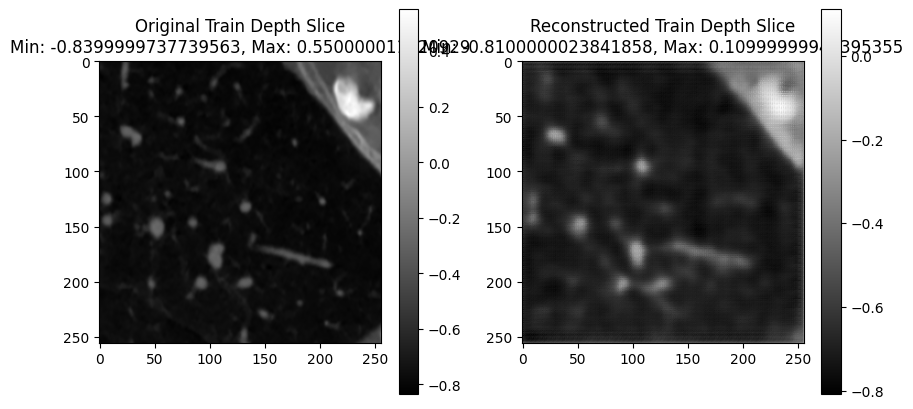

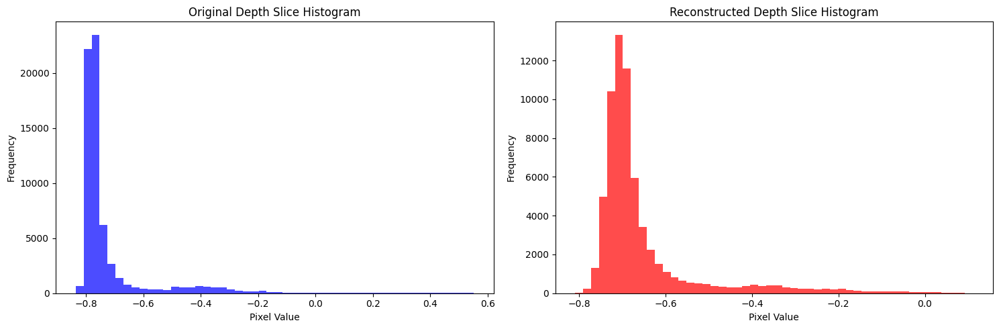

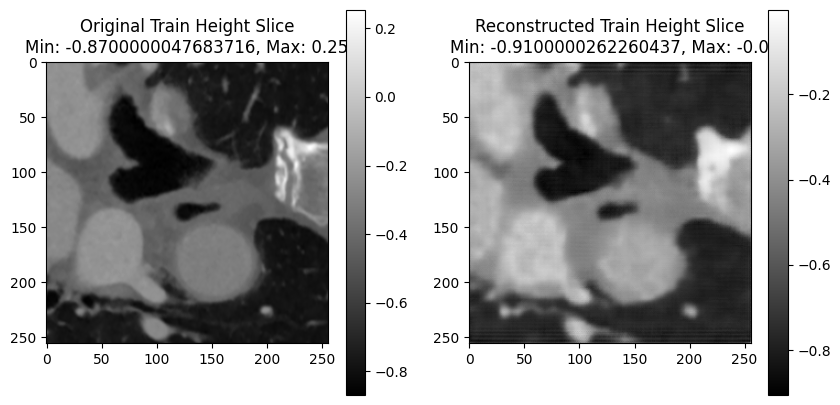

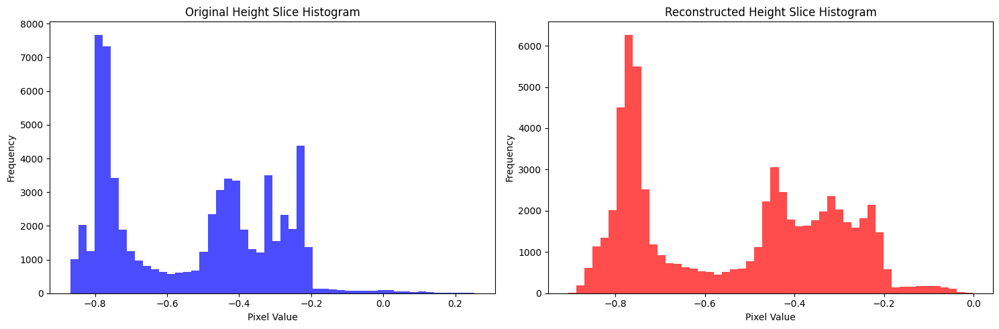

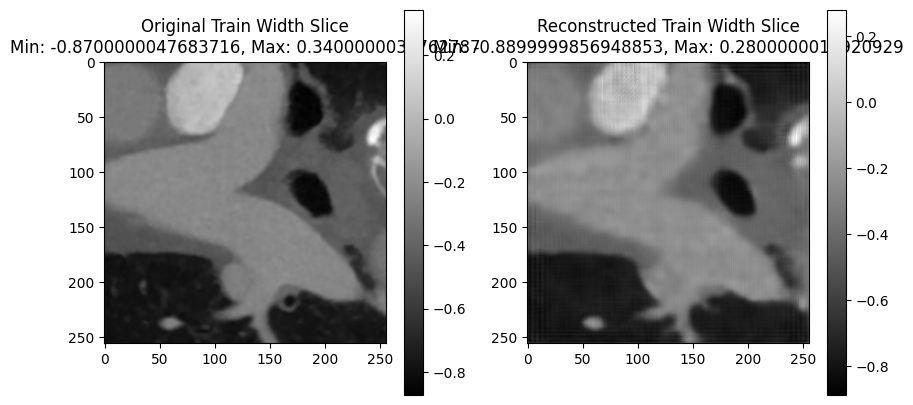

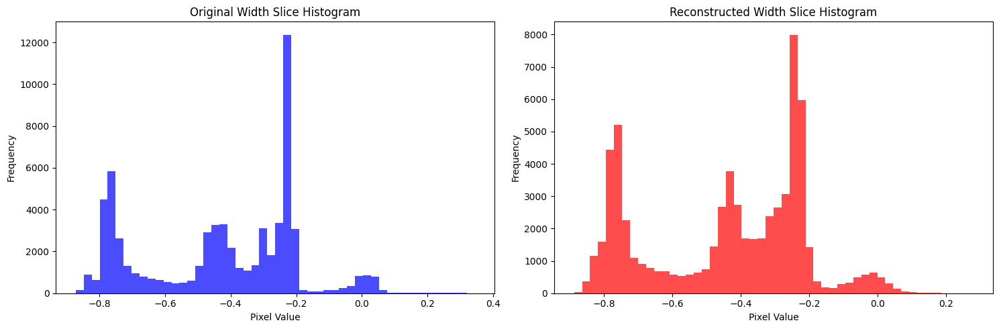

Validation: |          | 0/? [00:00<?, ?it/s]

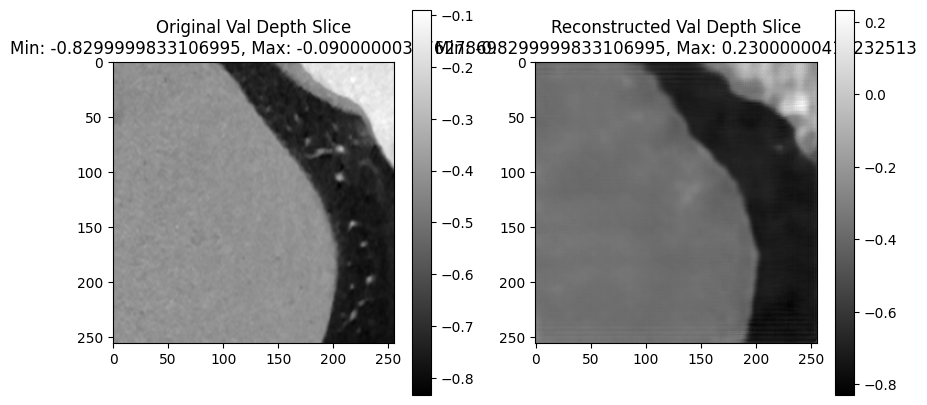

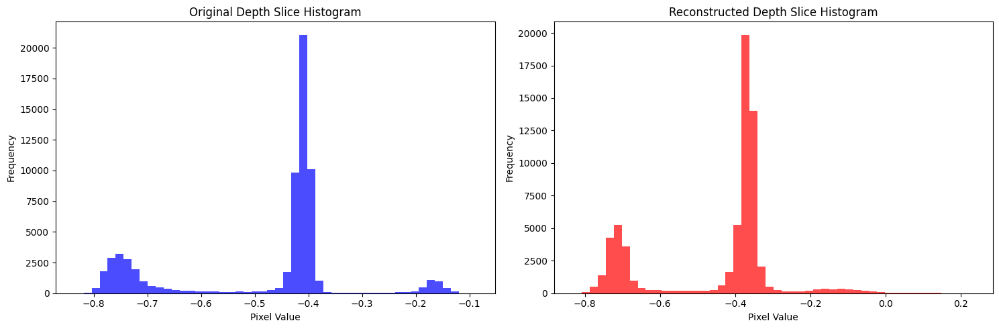

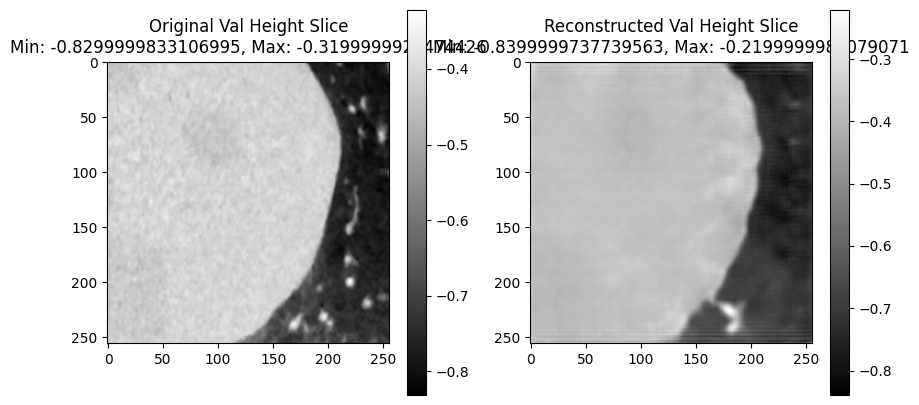

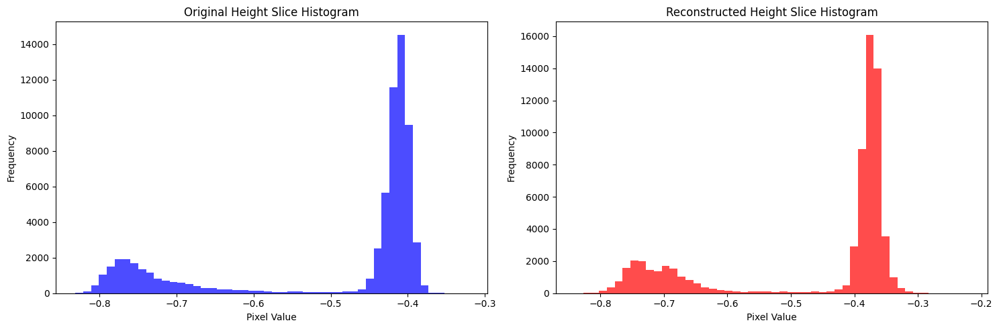

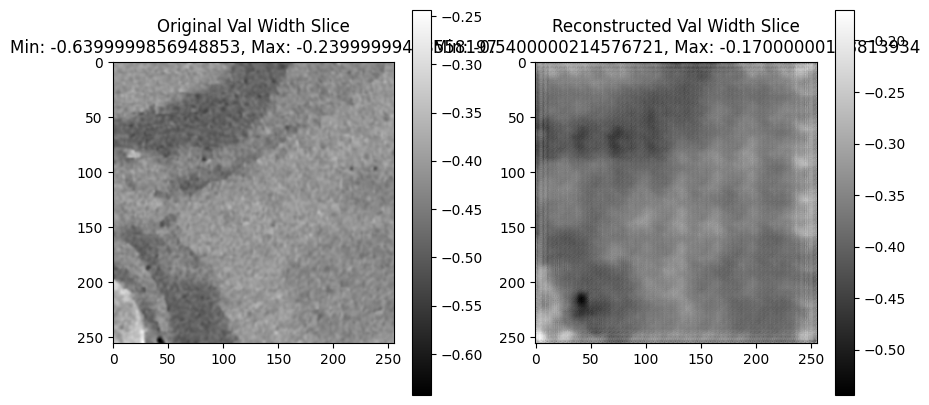

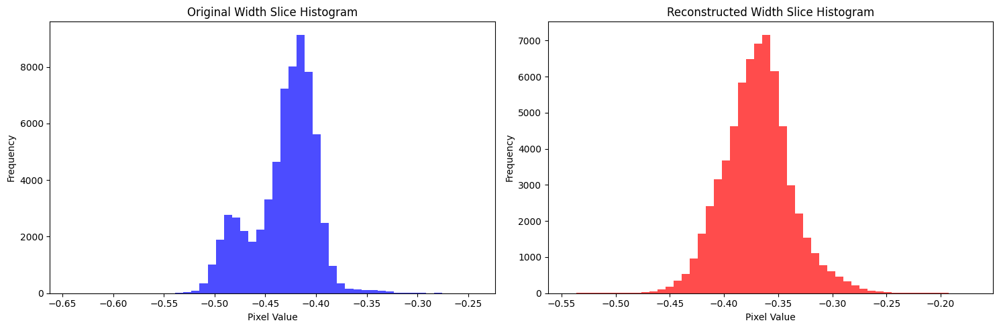

Time Spent 18841.09
Epoch: 1501


`Trainer.fit` stopped: `max_epochs=1501` reached.


FIT Profiler Report

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Action                                                                                                                                                           	|  Mean duration (s)	|  Num calls      	|  Total time (s) 	|  Percentage %   	|
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Total                                                                                                                                                            	|  -              	|  1086857      

In [5]:
# Initialize model and start training
ExperimentDescription = 'I-AE Job14 2C Loss'
ShowInterval = 300
model = AutoEncoderModel()
trainer.fit(model, train_dataloader, val_dataloader)
# torch.save(model.state_dict(), folder_path + '/aeSSIM.pth')